In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import string

In [2]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
df = pd.read_csv('/content/data_transactions.csv', header=0)

In [5]:
df

,description,bank_name,category
0,BRIVA1236213604191425NBMBTikTok Shop BRIVA 1...,BRI,Shopping
1,BRIVA8000817455611NBMBBukalapak an radit BRIV...,BRI,Shopping
2,BRIVA80888089620960434NBMBTOPTokopediaRi BRIV...,BRI,Shopping
3,BRIVA88099088296259128NBMBOVO BRIVA 880990882...,BRImo,Top Up
4,BRIVA88810895635976213NBMBDNID BINXXXX P BRIV...,BRI,Top Up
...,...,...,...
4679,Star Studio Digital Lab Studio,NaN,Entertainment
4680,Kinship Studio Bali,NaN,Entertainment
4681,Ayu Larasati Studio,NaN,Entertainment
4682,Zego Studio,NaN,Entertainment


**STAT TEST**

In [6]:
X_cat, y = df.iloc[:,:-1].copy(), df.iloc[:,-1].copy()

In [7]:
X_cat['bank_name'] = X_cat['bank_name'].fillna(value='Others')

In [8]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2


chi2_check = {}

for column in X_cat:
    prob = 0.95
    chi, p, dof, ex = chi2_contingency(pd.crosstab(X_cat[column],y))
    chi2_check.setdefault('Feature',[]).append(column)
    chi2_check.setdefault('chi',[]).append(chi)
    chi2_check.setdefault('p-value',[]).append(round(p, 10))
    chi2_check.setdefault('critical 0.05',[]).append(chi2.ppf(prob, dof))

chi2_result = pd.DataFrame(data = chi2_check)
chi2_result.sort_values(by = ['p-value'], ascending = True, ignore_index = True, inplace = True)
chi2_result

,Feature,chi,p-value,critical 0.05
0,bank_name,2886.511813,0.000000,557.334554
1,description,196716.656739,0.042217,196666.020314




*   If Statistic >= Critical Value: significant result, reject null hypothesis (H0), dependent.
*   If Statistic < Critical Value: not significant result, fail to reject null hypothesis (H0), independent.





*   If p-value <= alpha: significant result, reject null hypothesis (H0), dependent.
*   If p-value > alpha: not significant result, fail to reject null hypothesis (H0), independent.



In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4684 entries, 0 to 4683
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   description  4684 non-null   object
 1   bank_name    2984 non-null   object
 2   category     4684 non-null   object
dtypes: object(3)
memory usage: 109.9+ KB


In [10]:
df['bank_name'].unique()

array(['BRI', 'BRImo', nan, 'Danamon', 'D-Mobile', "Livin' by Mandiri",
       'KlikBCA', 'BNI', 'PermataNet', 'BSI', 'GoPay', 'OVO', 'CIMB'],
      dtype=object)

In [11]:
df['category'].unique()

array(['Shopping', 'Top Up', 'Fees & Charges', 'Public Transport',
       'Taxes', 'Telephone & Internet', 'Investment', 'Loan',
       'Cash Withdrawal', 'Transport', 'Home / Rent',
       'Service & Auto Parts', 'Donation & Social', 'Travel', 'Education',
       'Insurance', 'Electricity & Water Bills', 'Groceries & General',
       'Credit Card', 'Subscription', 'Food & Drink',
       'Books & Stationery', 'Fashion', 'Gas & Fuel', 'Entertainment',
       'Household Tools', 'Kids', 'Health & Medical', 'Beauty & Care',
       'Gadget & Electronics', 'Dentist', 'Pets', 'Services Needs',
       'Family', 'Car Loan', 'Home Loan', 'Gifts', 'Business Expense',
       'Sports', 'Laundry', 'Eye Care', 'Shipping', 'Printshop'],
      dtype=object)

In [ ]:
#df['bank_name'] = df['bank_name'].fillna(value='Others') # Replace NaN value dengan Others (LAKUIN PAS UDH PREPROCESSING KARENA MASIH BISA LABELIN SESUAI BANK_NAME)

In [12]:
df[df['bank_name'].isnull()]

,description,bank_name,category
10,KAIACCESS Pembayaran,NaN,Public Transport
52,BY TRX BIFAST,NaN,Fees & Charges
53,OVO Biaya Top Up,NaN,Fees & Charges
56,gobills - prudential premi kontribusi lanjutan,NaN,Insurance
61,axis pembayaran,NaN,Telephone & Internet
...,...,...,...
4679,Star Studio Digital Lab Studio,NaN,Entertainment
4680,Kinship Studio Bali,NaN,Entertainment
4681,Ayu Larasati Studio,NaN,Entertainment
4682,Zego Studio,NaN,Entertainment


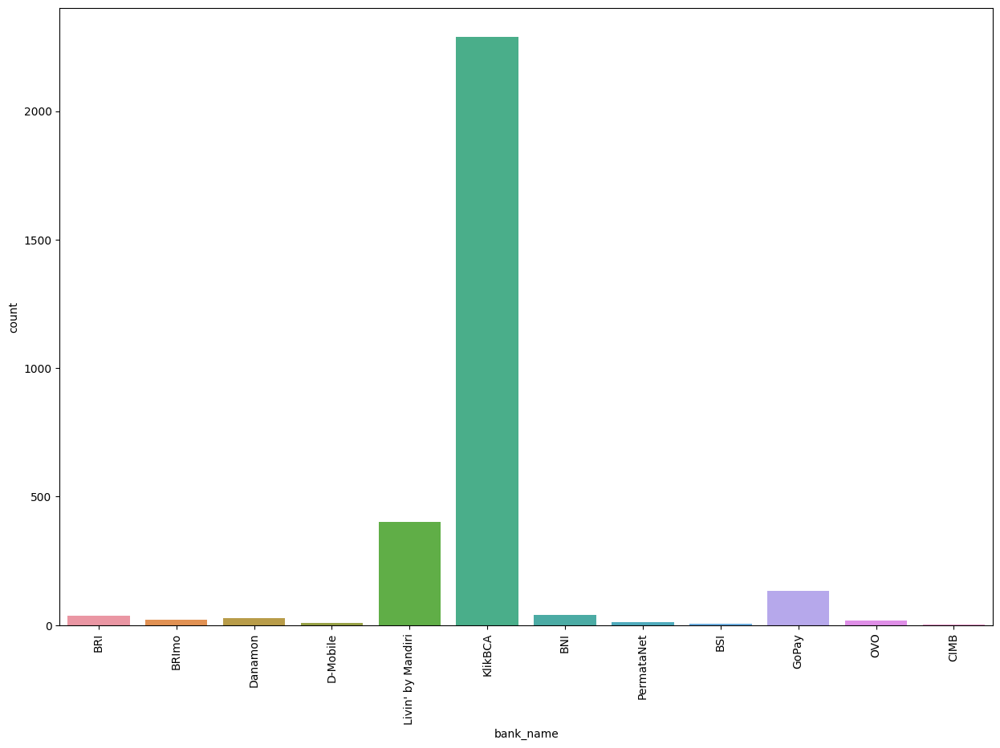

In [13]:
plt.figure(figsize=(15,10))
sns.countplot(data=df, x='bank_name')
plt.xticks(rotation=90)
plt.show()

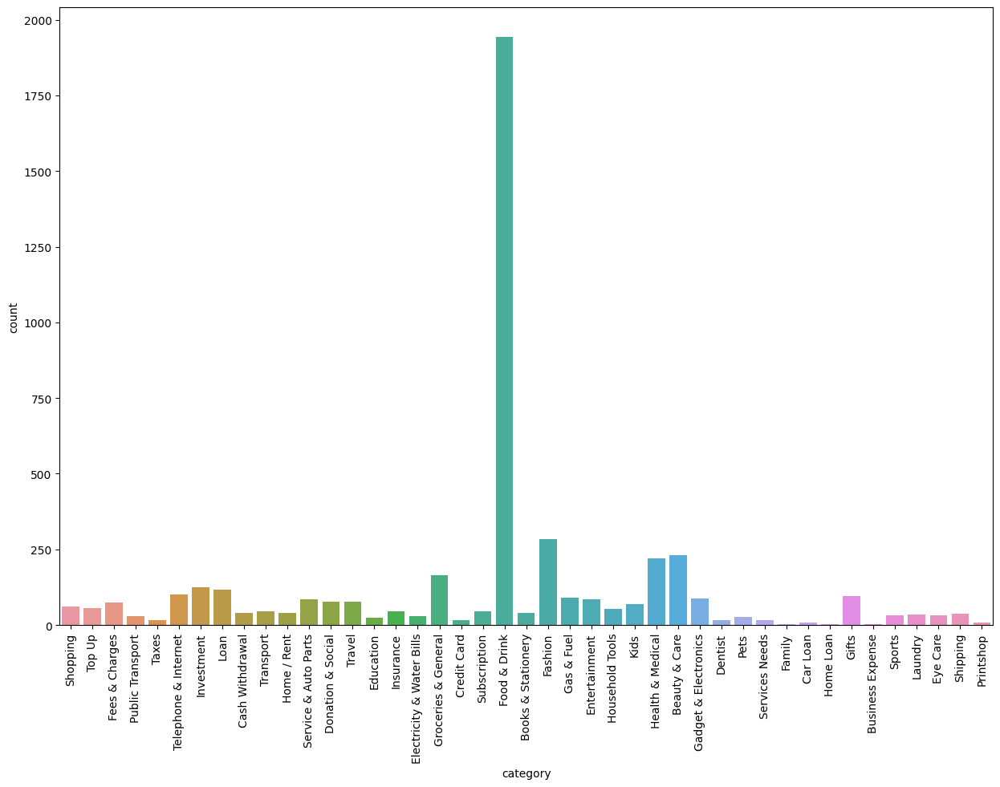

In [14]:
plt.figure(figsize=(15,10))
sns.countplot(data=df, x='category')
plt.xticks(rotation=90)
plt.show()

In [15]:
import json

with open('/content/synonym (1).json', 'r') as f: #read
  contraction_dict = json.load(f)
f.close()

In [ ]:
#contraction_dict = {k.upper():v.upper() for k,v in contraction_dict.items()}

In [ ]:
'''with open("/content/drive/MyDrive/PINA dataset/synonym.json", "w") as f: #write
  json.dump(contraction_dict, f)
f.close()'''

In [16]:
contraction_dict

{'ADM': 'ADMINISTRASI',
 'TXN': 'TRANSFER',
 'TRSF': 'TRANSFER',
 'TRF': 'TRANSFER',
 'INHOUSETRF': 'TRANSFER',
 'CR': 'CREDIT',
 'KR': 'CREDIT',
 'DB': 'DEBIT',
 'CWD': 'CASH WITHDRAWAL',
 'CSH': 'CASH',
 'WDRW': 'WITHDRAWAL',
 'WDRAW': 'WITHDRAWAL',
 'W/DRAWAL': 'WITHDRAWAL',
 'WDR': 'WITHDRAWAL',
 'W/D': 'WITHDRAWAL',
 'CCARD': 'CREDIT CARD',
 'PYM': 'PAYMENT',
 'CCPYM': 'CREDIT CARD PAYMENT',
 'APT': 'APOTEK',
 'APOTIK': 'APOTEK',
 'KF': 'KIMIA FARMA',
 'MARK': 'MARKET',
 'SBUX': 'STARBUCKS',
 'KOPI': 'COFFEE',
 'COFF': 'COFFEE',
 'KOFFEE': 'COFFEE',
 'TRX': 'TRANSFER',
 'ADMIN': 'ADMINISTRASI',
 'PEMINDAHBUKUAN': 'TRANSFER',
 'GOP': 'GOPAY',
 'ANGS': 'ANGSURAN',
 'ANG': 'ANGSURAN',
 'DNID': 'DANA',
 'BYR': 'BAYAR',
 'TOPUP': 'TOP UP',
 'AGF': 'AUTO GRAB FUND',
 'BELM': 'BUTIK EMAS LOGAM MULIA',
 'KRIPTO': 'CRYPTO',
 'TLJ': 'TOUS LES JOURS',
 'ALFAMRT': 'ALFAMART',
 'ULTAH': 'ULANG TAHUN',
 'GOPA': 'GOPAY',
 'APART': 'APARTEMENT',
 'BLIB': 'BLIBLI',
 'UTANG': 'HUTANG',
 'RM': 'RUMA

In [17]:
dict_buat_ditambahin = {'NBMB':'NEW BRI MOBILE BANKING', 'KK':'KARTU KREDIT', 'DIRECTDB':'DIRECT DEBIT','NP':'NATIONAL PAYMENT', 'DNID':'DANA ID', 'POS':'POINT OF SALE','AN': 'ATAS NAMA', 'PUL': 'PULSA', 'BUTAB':'BUKU TABUNGAN', 'RPY':'REPAYMENT', 'LN':'LINK', 'EDC': 'ELECTRONIC DATA CAPTURE', 'EDCKUP':'ELECTRONIC DATA CAPTURE', 'IBNK':'INTERNET BANKING', 'AS':'KARTU AS', 'SIM':'SIMPATI','MTR':'MENTARI', 'IM':'IM3', 'MPN':'MODUL PENERIMAAN NEGARA', 'TOKOPE':'TOKOPEDIA', 'PPH':'PAJAK PENGHASILAN', 'PT': 'PERUSAHAAN TERBUKA','IB':'ISLAMIC BANKING','BU':'IBU','AC':'AIR CONDITIONER','MAKN':'MAKAN','HP':'HANDPHONE','CUST':'CUSTOMER','ASRNS':'ASURANSI','PAYM':'PAYMENT','PAY':'PAYMENT', 'BI':'BANK INDONESIA', 'MCM':'MANDIRI CASH MANAGEMENT'}

In [18]:
for i, j in dict_buat_ditambahin.items():
  if i not in contraction_dict.keys():
    contraction_dict.update({i: j})

In [19]:
contraction_dict

{'ADM': 'ADMINISTRASI',
 'TXN': 'TRANSFER',
 'TRSF': 'TRANSFER',
 'TRF': 'TRANSFER',
 'INHOUSETRF': 'TRANSFER',
 'CR': 'CREDIT',
 'KR': 'CREDIT',
 'DB': 'DEBIT',
 'CWD': 'CASH WITHDRAWAL',
 'CSH': 'CASH',
 'WDRW': 'WITHDRAWAL',
 'WDRAW': 'WITHDRAWAL',
 'W/DRAWAL': 'WITHDRAWAL',
 'WDR': 'WITHDRAWAL',
 'W/D': 'WITHDRAWAL',
 'CCARD': 'CREDIT CARD',
 'PYM': 'PAYMENT',
 'CCPYM': 'CREDIT CARD PAYMENT',
 'APT': 'APOTEK',
 'APOTIK': 'APOTEK',
 'KF': 'KIMIA FARMA',
 'MARK': 'MARKET',
 'SBUX': 'STARBUCKS',
 'KOPI': 'COFFEE',
 'COFF': 'COFFEE',
 'KOFFEE': 'COFFEE',
 'TRX': 'TRANSFER',
 'ADMIN': 'ADMINISTRASI',
 'PEMINDAHBUKUAN': 'TRANSFER',
 'GOP': 'GOPAY',
 'ANGS': 'ANGSURAN',
 'ANG': 'ANGSURAN',
 'DNID': 'DANA',
 'BYR': 'BAYAR',
 'TOPUP': 'TOP UP',
 'AGF': 'AUTO GRAB FUND',
 'BELM': 'BUTIK EMAS LOGAM MULIA',
 'KRIPTO': 'CRYPTO',
 'TLJ': 'TOUS LES JOURS',
 'ALFAMRT': 'ALFAMART',
 'ULTAH': 'ULANG TAHUN',
 'GOPA': 'GOPAY',
 'APART': 'APARTEMENT',
 'BLIB': 'BLIBLI',
 'UTANG': 'HUTANG',
 'RM': 'RUMA

In [20]:
from nltk.corpus import stopwords

listStopword =  set(stopwords.words('indonesian'))

In [ ]:
# REMOVE DATA YANG []

In [ ]:
' '.join([]) == ''

True

In [ ]:
['BRI', 'BRImo', nan, 'Danamon', 'D-Mobile', "Livin' by Mandiri",
       'KlikBCA', 'BNI', 'PermataNet', 'BSI', 'GoPay', 'OVO', 'CIMB']

In [21]:
def lss2(text):
  txt = []
  for i in text.split():
    if len(i) <= 2:
      if i in not_remove:
        txt.append(i)
    else:
      txt.append(i)

  return ' '.join(txt)

def stpwrd(text):
  txt = []
  for i in text.split():
    if i not in listStopword:
      txt.append(i)
  return ' '.join(txt)

In [22]:
not_remove = ['go', 'cs', 'gl', 'xl', 'as', 'up', 'mi', 'qr', 'es', 've', 'rs', 'me', 'id', 'my', 'co']

In [23]:
# Normalisasi brand GO
def go_product(text):

  if len(text) != 0:
    
    text = text.split()

    if text[0]=='GO':
      text = text[0]+text[1] + ' ' + ' '.join([i for i in text[2:]])
    else:
      text = ' '.join([i for i in text])
  
  return text

In [24]:
def expand_contractions(s, contractions_dict=contraction_dict):
  text = []
  for i in s.split():
    if i in contractions_dict.keys():
      text.append(contractions_dict[i])
    else:
      text.append(i)
  return ' '.join(text)

In [25]:
def subs(text):
  
  text = re.sub(r'spotify', ' spotify ', text)
  text = re.sub(r'youtube', ' youtube ', text)
  text = re.sub(r' +', ' ', text)
  text = text.strip()

  return text

In [26]:
def gro(text):
  
  text = re.sub(r'indomaret', ' indomaret ', text)
  text = re.sub(r' +', ' ', text)
  text = text.strip()

  return text

In [27]:
def general(text):
  text = text.upper()
  text = re.sub(r'[0-9]+', ' ', text) #ilangin angka
  text = re.sub(r'NBMB', ' NBMB ', text)
  text = re.sub(r'TOP', ' TOP ', text)
  text = re.sub(r'PLN', ' PLN ', text)
  text = re.sub(r'ESB', '', text)
  text = re.sub(r'TOKOPEDIA', ' TOKOPEDIA ', text)
  text = re.sub(r'[\!\"\#\$\%\&\'\(\)\*\+\,\-\.\/\:\;\<\=\>\?\@\[\\\]\^\_\`\{\|\}\~]', ' ', text)
  #text = re.sub(r'[^\w\s]', ' ', text) #ilangin punctuation
  #text = re.sub(r'_',' ',text)
  text = re.sub(r' +', ' ', text) #ilangin more space
  text = text.strip() #ilangin spasi di awal dan akhir kalimat
  text = ' '.join([i for i in text.split() if len(i)>1])
  text = go_product(text)
  text = expand_contractions(text)
  text = ' '.join(dict.fromkeys(text.split()))
  text = text.lower()
  text = lss2(text)
  text = stpwrd(text)
  text = subs(text)
  text = gro(text)
  return text

In [29]:
df['description'][df['bank_name']=='GoPay'].apply(lambda x: general(x))

1770                         gobirdcombo
1771    gofood fore coffee tanjung duren
1772     gofood bebek kaleyo kemanggisan
1773                              goride
1774      gomart alfamart anggrek garuda
                      ...               
3714                           loket com
3715                           geulis id
3716                             akulaku
3717                            periplus
3718                        periplus com
Name: description, Length: 133, dtype: object

In [28]:
df['bank_name'] = df['bank_name'].fillna(value='Others') # Replace NaN value dengan Others (LAKUIN PAS UDH PREPROCESSING KARENA MASIH BISA LABELIN SESUAI BANK_NAME)

In [30]:
df['description'] = df['description'].apply(lambda x: general(x))

In [31]:
df

,description,bank_name,category
0,briva new bri mobile banking tiktok shop,BRI,Shopping
1,briva new bri mobile banking bukalapak nama radit,BRI,Shopping
2,briva new bri mobile banking top tokopedia,BRI,Shopping
3,briva new bri mobile banking ovo,BRImo,Top Up
4,briva new bri mobile banking dana binxxxx,BRI,Top Up
...,...,...,...
4679,star studio digital lab,Others,Entertainment
4680,kinship studio bali,Others,Entertainment
4681,ayu larasati studio,Others,Entertainment
4682,zego studio,Others,Entertainment


In [32]:
def itung(x):
  return len(x.split())

In [33]:
df['count'] = df['description'].apply(lambda x: itung(x))

In [34]:
df = df[~(df['count']==0)].reset_index(drop=True)

In [35]:
df.drop('count', axis=1, inplace=True)

In [36]:
df

,description,bank_name,category
0,briva new bri mobile banking tiktok shop,BRI,Shopping
1,briva new bri mobile banking bukalapak nama radit,BRI,Shopping
2,briva new bri mobile banking top tokopedia,BRI,Shopping
3,briva new bri mobile banking ovo,BRImo,Top Up
4,briva new bri mobile banking dana binxxxx,BRI,Top Up
...,...,...,...
4672,star studio digital lab,Others,Entertainment
4673,kinship studio bali,Others,Entertainment
4674,ayu larasati studio,Others,Entertainment
4675,zego studio,Others,Entertainment


In [ ]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
df['category'] = le.fit_transform(df['category'])

In [ ]:
keys = le.classes_
values = le.transform(le.classes_)
dictionary = dict(zip(keys, values))
print(dictionary)

{'Beauty & Care': 0, 'Books & Stationery': 1, 'Business Expense': 2, 'Car Loan': 3, 'Cash Withdrawal': 4, 'Credit Card': 5, 'Dentist': 6, 'Donation & Social': 7, 'Education': 8, 'Electricity & Water Bills': 9, 'Entertainment': 10, 'Eye Care': 11, 'Family': 12, 'Fashion': 13, 'Fees & Charges': 14, 'Food & Drink': 15, 'Gadget & Electronics': 16, 'Gas & Fuel': 17, 'Gifts': 18, 'Groceries & General': 19, 'Health & Medical': 20, 'Home / Rent': 21, 'Home Loan': 22, 'Household Tools': 23, 'Insurance': 24, 'Investment': 25, 'Kids': 26, 'Laundry': 27, 'Loan': 28, 'Pets': 29, 'Printshop': 30, 'Public Transport': 31, 'Service & Auto Parts': 32, 'Services Needs': 33, 'Shipping': 34, 'Shopping': 35, 'Sports': 36, 'Subscription': 37, 'Taxes': 38, 'Telephone & Internet': 39, 'Top Up': 40, 'Transport': 41, 'Travel': 42}


In [ ]:
re = {v:k for k,v in dictionary.items()}
print(re)

{0: 'Beauty & Care', 1: 'Books & Stationery', 2: 'Business Expense', 3: 'Car Loan', 4: 'Cash Withdrawal', 5: 'Credit Card', 6: 'Dentist', 7: 'Donation & Social', 8: 'Education', 9: 'Electricity & Water Bills', 10: 'Entertainment', 11: 'Eye Care', 12: 'Family', 13: 'Fashion', 14: 'Fees & Charges', 15: 'Food & Drink', 16: 'Gadget & Electronics', 17: 'Gas & Fuel', 18: 'Gifts', 19: 'Groceries & General', 20: 'Health & Medical', 21: 'Home / Rent', 22: 'Home Loan', 23: 'Household Tools', 24: 'Insurance', 25: 'Investment', 26: 'Kids', 27: 'Laundry', 28: 'Loan', 29: 'Pets', 30: 'Printshop', 31: 'Public Transport', 32: 'Service & Auto Parts', 33: 'Services Needs', 34: 'Shipping', 35: 'Shopping', 36: 'Sports', 37: 'Subscription', 38: 'Taxes', 39: 'Telephone & Internet', 40: 'Top Up', 41: 'Transport', 42: 'Travel'}


# Word2Vec

In [ ]:
import io
import time
from datetime import timedelta

import gensim

In [ ]:
'''start_time = time.time()

id_wiki = gensim.corpora.WikiCorpus(
    '/content/drive/MyDrive/idwiki-20221120-pages-articles-multistream.xml.bz2', dictionary={}, lower=True
)

article_count = 0

with io.open('idwiki_new_lower.txt', 'w', encoding='utf-8') as wiki_txt:
    for text in id_wiki.get_texts():
        wiki_txt.write(" ".join(text) + '\n')
        article_count += 1
        if article_count % 10000 == 0:
            print('{} articles processed'.format(article_count))
    print('total: {} articles'.format(article_count))

finish_time = time.time()
print('Elapsed time: {}'.format(timedelta(seconds=finish_time-start_time)))'''

10000 articles processed
20000 articles processed
30000 articles processed
40000 articles processed
50000 articles processed
60000 articles processed
70000 articles processed
80000 articles processed
90000 articles processed
100000 articles processed
110000 articles processed
120000 articles processed
130000 articles processed
140000 articles processed
150000 articles processed
160000 articles processed
170000 articles processed
180000 articles processed
190000 articles processed
200000 articles processed
210000 articles processed
220000 articles processed
230000 articles processed
240000 articles processed
250000 articles processed
260000 articles processed
270000 articles processed
280000 articles processed
290000 articles processed
300000 articles processed
310000 articles processed
320000 articles processed
330000 articles processed
340000 articles processed
350000 articles processed
360000 articles processed
370000 articles processed
380000 articles processed
390000 articles proce

In [ ]:
import time
import multiprocessing
from datetime import timedelta

from gensim.models import word2vec

In [ ]:
'''start_time = time.time()
print('Training Word2Vec Model...')
sentences = word2vec.LineSentence('/content/idwiki_new_lower.txt')
id_w2v = word2vec.Word2Vec(sentences, vector_size=200, workers=multiprocessing.cpu_count()-1)
id_w2v.save('/content/drive/MyDrive/idwiki_word2vec.model')
finish_time = time.time()
print('Finished. Elapsed time: {}'.format(timedelta(seconds=finish_time-start_time)))'''

Training Word2Vec Model...
Finished. Elapsed time: 0:32:27.782880


# COBA Word2Vec

In [37]:
from gensim.models import Word2Vec
import random

# Load the pre-trained Word2Vec model
model = Word2Vec.load('/content/drive/MyDrive/idwiki_word2vec.model')

In [ ]:
# Get the most similar words to a given word
similar_words = model.wv.most_similar('mcdonald', topn=10)

# Print the results
for word, similarity in similar_words:
    print(f"{word}: {similarity}")

lawson: 0.7056233286857605
dunkin: 0.6369060277938843
starbucks: 0.6284921169281006
donuts: 0.624822199344635
gamble: 0.6064768433570862
breadtalk: 0.6042714715003967
walmart: 0.6022816300392151
sears: 0.5956324338912964
chipotle: 0.5906855463981628
foods: 0.5895385146141052


In [ ]:
from collections import Counter

print(Counter(df.category))

Counter({'Food & Drink': 1944, 'Fashion': 280, 'Beauty & Care': 229, 'Health & Medical': 219, 'Groceries & General': 165, 'Investment': 126, 'Loan': 116, 'Telephone & Internet': 101, 'Gifts': 95, 'Gas & Fuel': 90, 'Gadget & Electronics': 88, 'Service & Auto Parts': 84, 'Entertainment': 84, 'Travel': 78, 'Donation & Social': 76, 'Fees & Charges': 75, 'Kids': 68, 'Shopping': 62, 'Top Up': 56, 'Household Tools': 52, 'Transport': 46, 'Insurance': 45, 'Subscription': 45, 'Cash Withdrawal': 40, 'Home / Rent': 40, 'Books & Stationery': 40, 'Shipping': 37, 'Laundry': 35, 'Sports': 33, 'Eye Care': 32, 'Public Transport': 30, 'Electricity & Water Bills': 29, 'Pets': 27, 'Education': 23, 'Credit Card': 16, 'Taxes': 15, 'Dentist': 15, 'Services Needs': 15, 'Printshop': 9, 'Car Loan': 7, 'Business Expense': 4, 'Family': 3, 'Home Loan': 3})


In [ ]:
df.description[df['category']=='Fees & Charges']#[1896]

6                              biaya administrasi
7                               biaya bulanan atm
8            biaya administrasi bulanan tunggakan
22                                atm decline fee
23      atm decline fee idm raweuy insuff balance
                          ...                    
4352                            pembayaran feewdw
4353                           pembayaran fee wdw
4354                            pembayaran feetrf
4355                      pembayaran fee transfer
4454                            embayaran feecsrp
Name: description, Length: 75, dtype: object

In [ ]:
# Choose a sentence to augment
sentence = "biaya administrasi bulanan tunggakan"

In [ ]:
def aug_word2vec(text):
  # Convert the sentence to a list of words
  words = text.split()

  # Set the number of similar words to use for augmentation
  n_similar = 3

  # Generate augmented sentences
  augmented_sentences = []
  for i, word in enumerate(words):
      if word in model.wv.key_to_index:
          # Get the `n_similar` most similar words to the current word
          similar_words = [x[0] for x in model.wv.most_similar(word, topn=n_similar)]

          # Replace the original word with each of the similar words to generate augmented sentences
          for similar_word in similar_words:
              augmented_words = words.copy()
              augmented_words[i] = similar_word
              augmented_sentences.append(' '.join(augmented_words))

  return augmented_sentences

In [ ]:
# Print the original and augmented sentences
print(f"Original sentence: {sentence}")
print("Augmented sentences:")
print(len(aug_word2vec(sentence)))
for s in aug_word2vec(sentence):
    print(s)

Original sentence: biaya administrasi bulanan tunggakan
Augmented sentences:
12
ongkos administrasi bulanan tunggakan
biayanya administrasi bulanan tunggakan
anggaran administrasi bulanan tunggakan
biaya administratif bulanan tunggakan
biaya adminstrasi bulanan tunggakan
biaya pemerintahan bulanan tunggakan
biaya administrasi mingguan tunggakan
biaya administrasi tahunan tunggakan
biaya administrasi langganan tunggakan
biaya administrasi bulanan menunggak
biaya administrasi bulanan utangnya
biaya administrasi bulanan cicilan


In this example, we set n_similar to 3, so for each word in the sentence, we generate 3 augmented sentences by replacing the word with its 3 most similar words in the Word2Vec model's vocabulary. 

In [38]:
def aug_word2vec(text):
  # Convert the sentence to a list of words
  words = text.split()

  # Set the number of similar words to use for augmentation
  n_similar = 10

  # Generate augmented sentences
  augmented_sentences = []
  for i, word in enumerate(words):
      if word in model.wv.key_to_index:
          # Get the `n_similar` most similar words to the current word
          similar_words = [x[0] for x in model.wv.most_similar(word, topn=n_similar)]

          # Replace the original word with each of the similar words to generate augmented sentences
          for similar_word in similar_words:
              augmented_words = words.copy()
              augmented_words[i] = similar_word
              augmented_sentences.append(' '.join(augmented_words))

  return augmented_sentences

In [39]:
def aug_text(x, category):

  data = []

  for i in x:
    data.extend(aug_word2vec(i))
  
  return pd.DataFrame({'description':data, 'category':[category]*len(data)})

# NLP AUG

In [ ]:
!pip install nlpaug

In [ ]:
!pip install transformers

In [ ]:
! pip install huggingface_hub
! pip install sentencepiece

In [ ]:
from huggingface_hub import notebook_login

notebook_login()

Token is valid.
Your token has been saved in your configured git credential helpers (store).
Your token has been saved to /root/.cache/huggingface/token
Login successful


In [ ]:
import nlpaug.augmenter.word as naw
from gensim.models import Word2Vec, KeyedVectors

In [ ]:
TOPK=20 #default=100
ACT = 'insert' #"substitute"
 
aug_bert = naw.ContextualWordEmbsAug(
    model_path='distilbert-base-uncased', 
    #device='cuda',
    action=ACT, top_k=TOPK)

In [ ]:
from collections import Counter

print(Counter(df.category))

Counter({'Food & Drink': 1944, 'Fashion': 280, 'Beauty & Care': 229, 'Health & Medical': 219, 'Groceries & General': 165, 'Investment': 126, 'Loan': 116, 'Telephone & Internet': 101, 'Gifts': 95, 'Gas & Fuel': 90, 'Gadget & Electronics': 88, 'Service & Auto Parts': 84, 'Entertainment': 84, 'Travel': 78, 'Donation & Social': 76, 'Fees & Charges': 75, 'Kids': 68, 'Shopping': 62, 'Top Up': 56, 'Household Tools': 52, 'Transport': 46, 'Insurance': 45, 'Subscription': 45, 'Cash Withdrawal': 40, 'Home / Rent': 40, 'Books & Stationery': 40, 'Shipping': 37, 'Laundry': 35, 'Sports': 33, 'Eye Care': 32, 'Public Transport': 30, 'Electricity & Water Bills': 29, 'Pets': 27, 'Education': 23, 'Credit Card': 16, 'Taxes': 15, 'Dentist': 15, 'Services Needs': 15, 'Printshop': 9, 'Car Loan': 7, 'Business Expense': 4, 'Family': 3, 'Home Loan': 3})


In [ ]:
df.description[df['category']=='Family']#[1896]

1479    transfer sdri jajan bunda dedek tabungan
1480                     mcm transfer cs istriku
2397                titip mama putria marthayuza
Name: description, dtype: object

In [ ]:
test_sentence = 'kartu debit nike factory'
print("Original:")
print('pemabayaran indomaret')
print("Augmented Text:")
for i in range(5):
    augmented_text = aug_bert.augment(test_sentence)
    print(augmented_text)

Original:
pemabayaran indomaret
Augmented Text:
['kartu municipal debit nike cement factory']
['yokohama kartu motor debit nike rubber factory']
['kartu tyre debit tyre nike tyre factory']
['lego kartu toys debit nike shoe factory']
['kartu municipal debit nike cement factory']


# DATA BARU DARI DB

In [40]:
!pip install wordcloud

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [41]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

In [42]:
df_baru = pd.read_csv('/content/drive/MyDrive/query_result_2023-03-20T08_54_01.743348Z.csv', header=0)

In [43]:
df_baru.head()

,ID,Created At,Updated At,Amount,Bank Name,Credit Debit,Date,Description,User Categorization,Vendor Categorization,Is Manual,Ml Approval,Ml Categorization,Ml Categorization Budget,Ml Confidence,Remark,Vendor Name,Clean Description,Ground Truth
0,4226aa1b-8f01-4a05-9c12-e50bbaee52ef,2022-10-23T22:40:35.371387,NaN,7770.0,OVO,D,2022-09-30T00:00:00Z,Google Play Pembayaran,NaN,NaN,NaN,NaN,"Langganan (Netflix, Spotify, dll)",NaN,0.999601,NaN,Onebrick,NaN,NaN
1,d356406c-c674-479c-a5f5-b0f6c5967a87,2022-10-23T22:40:35.369766,NaN,29200.0,OVO,D,2022-09-30T00:00:00Z,Grab Pembayaran,NaN,NaN,NaN,NaN,Makanan dan Minuman,NaN,0.832082,NaN,Onebrick,NaN,NaN
2,277d57e9-8a59-4fee-b2fa-58e2f75ff092,2022-10-23T22:40:35.368122,NaN,118000.0,OVO,D,2022-09-30T00:00:00Z,Grab Pembayaran,NaN,NaN,NaN,NaN,Makanan dan Minuman,NaN,0.832082,NaN,Onebrick,NaN,NaN
3,e20e16b4-0a8e-44fd-93bc-603276e7d56d,2022-10-23T22:40:35.367353,NaN,1000.0,OVO,D,2022-09-30T00:00:00Z,OVO Top Up Fee,NaN,NaN,NaN,NaN,Biaya Admin,NaN,0.999945,NaN,Onebrick,NaN,NaN
4,2e7b2a30-7bc9-4ed0-bbbb-eb9bd4fe604c,2022-10-23T22:40:35.365143,NaN,1000.0,OVO,D,2022-09-30T00:00:00Z,OVO Top Up Fee,NaN,NaN,NaN,NaN,Biaya Admin,NaN,0.999945,NaN,Onebrick,NaN,NaN


In [44]:
df['category'].unique()

array(['Shopping', 'Top Up', 'Fees & Charges', 'Public Transport',
       'Taxes', 'Telephone & Internet', 'Investment', 'Loan',
       'Cash Withdrawal', 'Transport', 'Home / Rent',
       'Service & Auto Parts', 'Donation & Social', 'Travel', 'Education',
       'Insurance', 'Electricity & Water Bills', 'Groceries & General',
       'Credit Card', 'Subscription', 'Food & Drink',
       'Books & Stationery', 'Fashion', 'Gas & Fuel', 'Entertainment',
       'Household Tools', 'Kids', 'Health & Medical', 'Beauty & Care',
       'Gadget & Electronics', 'Dentist', 'Pets', 'Services Needs',
       'Family', 'Car Loan', 'Home Loan', 'Gifts', 'Business Expense',
       'Sports', 'Laundry', 'Eye Care', 'Shipping', 'Printshop'],
      dtype=object)

In [45]:
from collections import Counter

print(Counter(df_baru['Ml Categorization']))

Counter({nan: 99242, 'Belanja Bulanan': 43715, 'Makanan dan Minuman': 40742, 'Top Up E-Wallet': 27002, 'Biaya Admin': 21039, 'Tarik Tunai': 16572, 'Transportasi Umum': 11823, 'Telepon, Handphone, dan Internet': 6940, 'Keperluan Lain': 5206, 'Investasi': 5031, 'Donasi': 3339, 'Pinjaman': 3285, 'Kesehatan dan Medis': 3011, 'Transportasi': 2936, 'Kartu Kredit': 2667, 'Langganan (Netflix, Spotify, dll)': 2538, 'Kebutuhan Rumah Tangga': 2164, 'Tagihan Listrik dan Air': 1643, 'Hiburan': 1557, 'Asuransi': 1001, 'Rumah / Sewa': 873, 'Perawatan Pribadi dan Kecantikan': 611, 'Pendidikan Pribadi': 511, 'Cicilan Rumah': 417, 'Hadiah': 223, 'Hewan Peliharaan': 143, 'Kebutuhan Anak': 101, 'Cicilan Mobil': 25, 'Uang untuk Orang Tua atau Istri': 4})


In [46]:
print(Counter(df['category']))

Counter({'Food & Drink': 1944, 'Fashion': 280, 'Beauty & Care': 229, 'Health & Medical': 219, 'Groceries & General': 165, 'Investment': 126, 'Loan': 116, 'Telephone & Internet': 101, 'Gifts': 95, 'Gas & Fuel': 90, 'Gadget & Electronics': 88, 'Service & Auto Parts': 84, 'Entertainment': 84, 'Travel': 78, 'Donation & Social': 76, 'Fees & Charges': 75, 'Kids': 68, 'Shopping': 62, 'Top Up': 56, 'Household Tools': 52, 'Transport': 46, 'Insurance': 45, 'Subscription': 45, 'Cash Withdrawal': 40, 'Home / Rent': 40, 'Books & Stationery': 40, 'Shipping': 37, 'Laundry': 35, 'Sports': 33, 'Eye Care': 32, 'Public Transport': 30, 'Electricity & Water Bills': 29, 'Pets': 27, 'Education': 23, 'Credit Card': 16, 'Taxes': 15, 'Dentist': 15, 'Services Needs': 15, 'Printshop': 9, 'Car Loan': 7, 'Business Expense': 4, 'Family': 3, 'Home Loan': 3})


In [47]:
df_baru['Ml Categorization'].unique()

array(['Langganan (Netflix, Spotify, dll)', 'Makanan dan Minuman',
       'Biaya Admin', 'Belanja Bulanan', 'Hiburan', nan, 'Investasi',
       'Pinjaman', 'Transportasi Umum', 'Transportasi',
       'Telepon, Handphone, dan Internet', 'Tarik Tunai',
       'Top Up E-Wallet', 'Tagihan Listrik dan Air', 'Keperluan Lain',
       'Kebutuhan Rumah Tangga', 'Donasi', 'Kesehatan dan Medis',
       'Perawatan Pribadi dan Kecantikan', 'Hadiah', 'Kartu Kredit',
       'Asuransi', 'Pendidikan Pribadi', 'Hewan Peliharaan',
       'Rumah / Sewa', 'Cicilan Rumah', 'Cicilan Mobil', 'Kebutuhan Anak',
       'Uang untuk Orang Tua atau Istri'], dtype=object)

## Fashion

In [48]:
data = df['description'][df['category']=='Fashion']

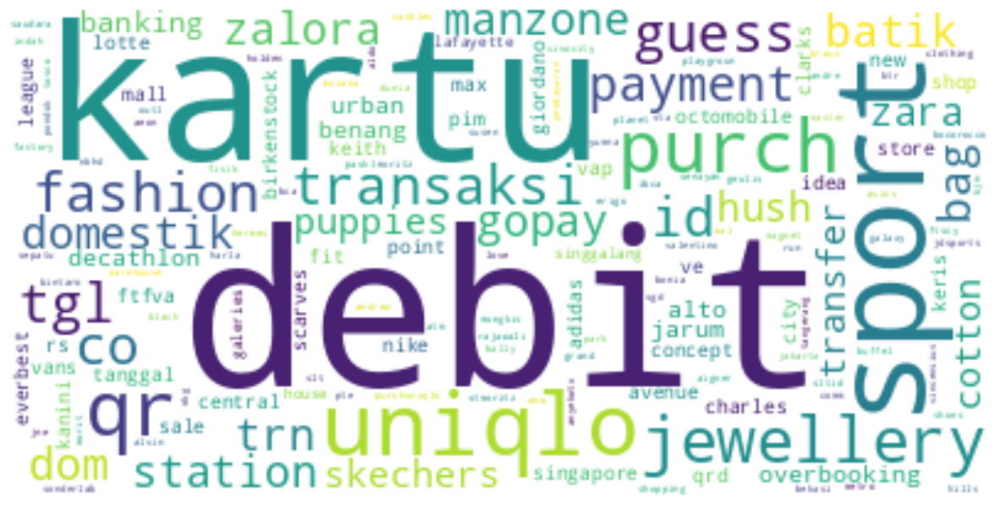

In [49]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [50]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 47), ('kartu', 34), ('sport', 12), ('uniqlo', 10), ('qr', 8), ('purch', 7), ('jewellery', 7), ('fashion', 5), ('transaksi', 5), ('tgl', 5)]
[('debit', 1.0), ('kartu', 0.723404255319149), ('sport', 0.2553191489361702), ('uniqlo', 0.2127659574468085), ('qr', 0.1702127659574468), ('purch', 0.14893617021276595), ('jewellery', 0.14893617021276595), ('fashion', 0.10638297872340426), ('transaksi', 0.10638297872340426), ('tgl', 0.10638297872340426)]


In [51]:
data = data[data.str.contains('uniqlo|nike|bag|adidas|vans')].reset_index(drop=True)

In [52]:
data

0                                    kartu debit adidas
1                        adidas vivocity nbhd singapore
2                                    kartu debit uniqlo
3                         transaksi debit tgl qr uniqlo
4     transfer banking debit ftscy nike run black jn...
5     overbooking atm master purchuniqlo singapore p...
6                              kartu debit nike factory
7            gopay payment uniqlo lotte shopping avenue
8                         gopay payment uniqlo aeon mal
9                                   purch rs uniqlo pim
10        debit domestik tanggal trn dom uniqlo bintaro
11    overbooking octomobile purch qrd qr off uniqlo...
12                                    qr payment uniqlo
13                                    purch alto uniqlo
14                                             bag city
15                                    diamond bags coll
16                                                 bags
17                                              

In [53]:
df_fashion = aug_text(data, 'Fashion')

In [54]:
df_fashion

,description,category
0,card debit adidas,Fashion
1,token debit adidas,Fashion
2,paspor debit adidas,Fashion
3,voucher debit adidas,Fashion
4,kotak debit adidas,Fashion
...,...,...
795,rimowa high quality luggage suitcases colored,Fashion
796,rimowa high quality luggage suitcases tricks,Fashion
797,rimowa high quality luggage suitcases vegetables,Fashion
798,rimowa high quality luggage suitcases bursting,Fashion


## Beauty & Care

In [55]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Perawatan Pribadi dan Kecantikan'].reset_index(drop=True).apply(lambda x: general(x))

In [56]:
df_BeaCare = pd.DataFrame({'description':data, 'category':['Beauty & Care']*len(data)}) 

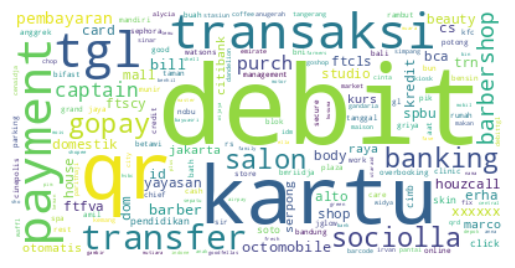

In [57]:
text = ' '.join([text for text in df_BeaCare['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [58]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 391), ('kartu', 182), ('qr', 177), ('transaksi', 126), ('payment', 123), ('tgl', 122), ('transfer', 86), ('banking', 78), ('sociolla', 75), ('gopay', 72)]
[('debit', 1.0), ('kartu', 0.46547314578005117), ('qr', 0.45268542199488493), ('transaksi', 0.32225063938618925), ('payment', 0.3145780051150895), ('tgl', 0.31202046035805625), ('transfer', 0.21994884910485935), ('banking', 0.19948849104859334), ('sociolla', 0.1918158567774936), ('gopay', 0.18414322250639387)]


In [59]:
df_BeaCare = df_BeaCare[~(df_BeaCare['description'].str.contains('secure|parking'))].reset_index(drop=True)

In [60]:
df_BeaCare

,description,category
0,debit domestik tanggal trn dom farmanina beauty,Beauty & Care
1,qr payment richdjoe barbershop,Beauty & Care
2,kartu debit sociolla kemang,Beauty & Care
3,transfer bifast esther yurike bank central asi...,Beauty & Care
4,goshop erha clinic,Beauty & Care
...,...,...
599,kartu debit bath body works,Beauty & Care
600,transfer banking debit kartu milica yayasan pe...,Beauty & Care
601,kartu debit may salon puri,Beauty & Care
602,kartu debit sociolla store,Beauty & Care


## Health & Medical

In [61]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Kesehatan dan Medis'].reset_index(drop=True).apply(lambda x: general(x))

In [62]:
df_hm = pd.DataFrame({'description':data, 'category':['Health & Medical']*len(data)}) 

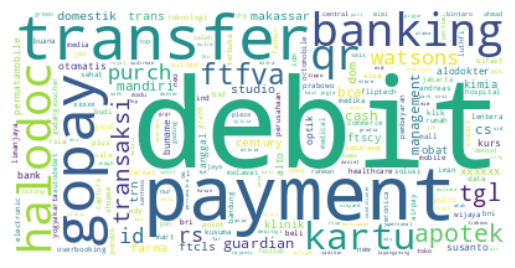

In [63]:
text = ' '.join([text for text in df_hm['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [64]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 1432), ('payment', 992), ('transfer', 812), ('gopay', 728), ('banking', 589), ('halodoc', 582), ('qr', 505), ('kartu', 499), ('ftfva', 253), ('apotek', 247)]
[('debit', 1.0), ('payment', 0.6927374301675978), ('transfer', 0.5670391061452514), ('gopay', 0.5083798882681564), ('banking', 0.41131284916201116), ('halodoc', 0.4064245810055866), ('qr', 0.3526536312849162), ('kartu', 0.348463687150838), ('ftfva', 0.17667597765363127), ('apotek', 0.17248603351955308)]


In [65]:
df_hm = df_hm[~(df_hm['description'].str.contains('secure|parking'))].reset_index(drop=True)

In [66]:
df_hm = df_hm.iloc[0:500]

In [67]:
df_hm

,description,category
0,transfer banking debit ftfva halodoc,Health & Medical
1,transfer banking debit ftfva halodoc,Health & Medical
2,transfer banking debit ftfva halodoc,Health & Medical
3,transfer banking debit ftfva halodoc,Health & Medical
4,kartu debit guardian grand ind,Health & Medical
...,...,...
495,debit otomatis ftcls kurs xxxxxx swab antigen ...,Health & Medical
496,mayapada lebak bulus hospital,Health & Medical
497,halodoc,Health & Medical
498,gopay payment alodokter com cbd dba qpyyntz ahid,Health & Medical


## Groceries & General

In [68]:
data = df['description'][df['category']=='Groceries & General']

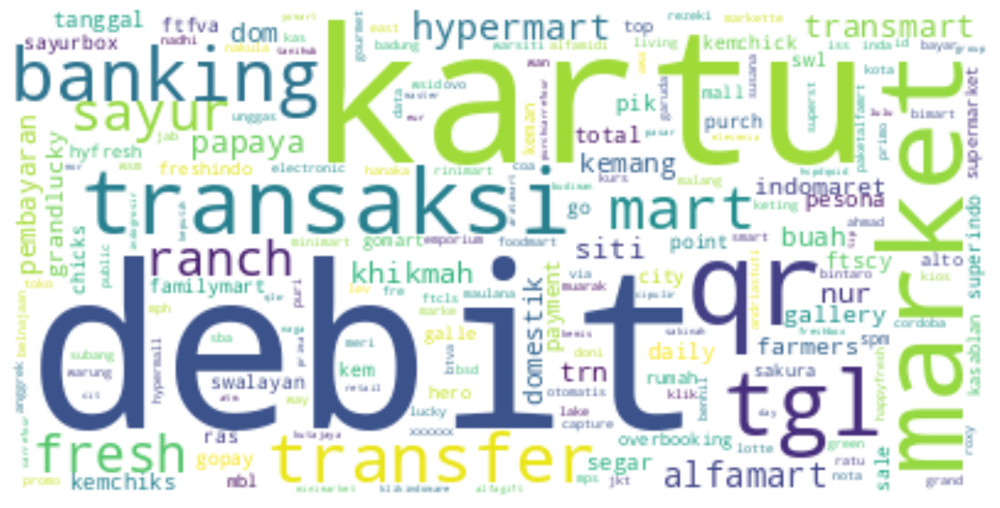

In [69]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [70]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 133), ('kartu', 86), ('market', 22), ('qr', 22), ('transaksi', 21), ('tgl', 21), ('banking', 20), ('transfer', 19), ('mart', 15), ('sayur', 12)]
[('debit', 1.0), ('kartu', 0.6466165413533834), ('market', 0.16541353383458646), ('qr', 0.16541353383458646), ('transaksi', 0.15789473684210525), ('tgl', 0.15789473684210525), ('banking', 0.15037593984962405), ('transfer', 0.14285714285714285), ('mart', 0.11278195488721804), ('sayur', 0.09022556390977443)]


In [71]:
data = data[data.str.contains('indomaret|alfamart|hypermart|transmart|familymart|sayurbox')].reset_index(drop=True)

In [72]:
data

0                 bayar via banking wsid klik indomaret
1     debit domestik tanggal trn dom transmart emporium
2           debit domestik tanggal trn dom alfamart mbl
3           debit domestik tanggal trn dom alfamart mbl
4                                   point sale alfamart
5                                              sayurbox
6                        gomart alfamart anggrek garuda
7                     promo hypermart kemang pembayaran
8             debit domestik trn dom transmart kota kas
9     debit otomatis tanggal ftcls kurs xxxxxx alfamart
10                                 kartu debit alfamart
11                            kartu debit alfamart btva
12                         kartu debit indomaret benhil
13                       kartu debit transmart kasablan
14                         kartu debit hypermart kemang
15                         kartu debit hypermart pesona
16                       kartu debit hypermart east coa
17                         kartu debit hypermart

In [73]:
df_groceries = aug_text(data, 'Groceries & General')

In [74]:
df_groceries

,description,category
0,cicilan via banking wsid klik indomaret,Groceries & General
1,menagih via banking wsid klik indomaret,Groceries & General
2,membayar via banking wsid klik indomaret,Groceries & General
3,pembayaran via banking wsid klik indomaret,Groceries & General
4,melunasi via banking wsid klik indomaret,Groceries & General
...,...,...
1575,transfer banking debit ftscy chatime,Groceries & General
1576,transfer banking debit ftscy perkulakan,Groceries & General
1577,transfer banking debit ftscy supermarket,Groceries & General
1578,transfer banking debit ftscy breadtalk,Groceries & General


## Invesment

In [75]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Investasi'].reset_index(drop=True).apply(lambda x: general(x))

In [76]:
df_inv = pd.DataFrame({'description':data, 'category':['Investment']*len(data)})

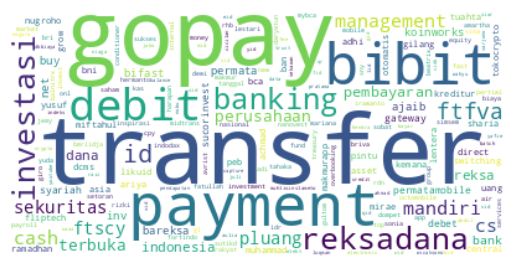

In [77]:
text = ' '.join([text for text in df_inv['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [78]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('transfer', 2274), ('gopay', 2093), ('payment', 2077), ('bibit', 1926), ('debit', 1426), ('reksadana', 1424), ('investasi', 1403), ('banking', 1285), ('id', 883), ('ftfva', 672)]
[('transfer', 1.0), ('gopay', 0.9204045734388743), ('payment', 0.9133685136323659), ('bibit', 0.8469656992084432), ('debit', 0.6270888302550571), ('reksadana', 0.6262093227792436), ('investasi', 0.6169744942832014), ('banking', 0.5650835532102023), ('id', 0.38830255057167984), ('ftfva', 0.2955145118733509)]


In [79]:
df_inv = df_inv[df_inv['description'].str.contains('bibit|reksadana|investasi|ftva')].reset_index(drop=True)

In [80]:
df_inv = df_inv.iloc[0:500]

In [81]:
df_inv

,description,category
0,transfer banking debit ftfva bibit id,Investment
1,transfer banking debit ftfva bibit id,Investment
2,transfer banking debit ftfva bibit id,Investment
3,transfer banking debit ftfva bibit id,Investment
4,transfer banking debit ftfva bibit id,Investment
...,...,...
495,gopay payment bibit investasi reksadana xks veqid,Investment
496,gopay payment bibit investasi reksadana dndvjo...,Investment
497,gopay payment bibit investasi reksadana cqyoj ...,Investment
498,gopay payment bibit investasi reksadana nrcwrrdid,Investment


## Loan

In [82]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Pinjaman'].reset_index(drop=True).apply(lambda x: general(x))

In [83]:
df_pin = pd.DataFrame({'description':data, 'category':['Loan']*len(data)})

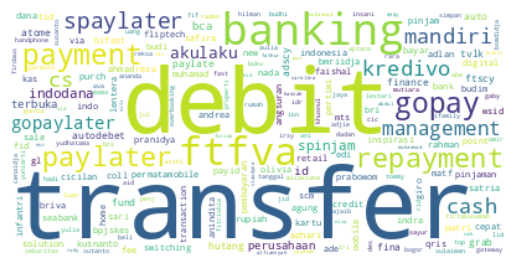

In [84]:
text = ' '.join([text for text in df_pin['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [85]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('transfer', 2364), ('debit', 1976), ('banking', 1955), ('ftfva', 1623), ('payment', 718), ('gopay', 696), ('paylater', 645), ('repayment', 637), ('spaylater', 392), ('kredivo', 357)]
[('transfer', 1.0), ('debit', 0.8358714043993232), ('banking', 0.8269881556683587), ('ftfva', 0.6865482233502538), ('payment', 0.30372250423011843), ('gopay', 0.29441624365482233), ('paylater', 0.27284263959390864), ('repayment', 0.2694585448392555), ('spaylater', 0.1658206429780034), ('kredivo', 0.15101522842639595)]


In [86]:
df_pin = df_pin[df_pin['description'].str.contains('paylater|spaylater|kredivo')].reset_index(drop=True)

In [87]:
df_pin = df_pin.iloc[0:500]

In [88]:
df_pin

,description,category
0,gopay payment paylater repayment tsks mipbsid,Loan
1,transfer banking debit ftfva spaylater,Loan
2,transfer banking debit ftfva spaylater,Loan
3,gopay payment paylater repayment xestdpid,Loan
4,gopay payment paylater repayment cop lmdtk id,Loan
...,...,...
495,transfer banking debit ftfva kredivo,Loan
496,transfer banking debit ftfva kredivo,Loan
497,transfer banking debit ftfva kredivo,Loan
498,gopay payment paylater repayment ydcpbu lhid,Loan


## Telephone & Internet

In [89]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Telepon, Handphone, dan Internet'].reset_index(drop=True).apply(lambda x: general(x))

In [90]:
df_tepin = pd.DataFrame({'description':data, 'category':['Telephone & Internet']*len(data)})

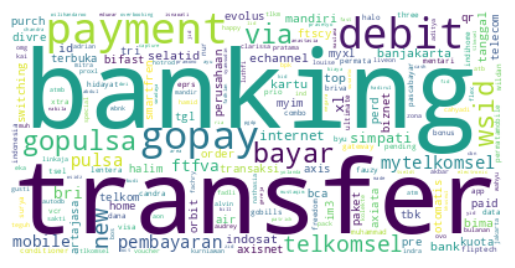

In [91]:
text = ' '.join([text for text in df_tepin['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [92]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('banking', 2391), ('transfer', 2360), ('payment', 1643), ('debit', 1557), ('gopay', 1427), ('gopulsa', 774), ('bayar', 770), ('via', 756), ('wsid', 742), ('telkomsel', 730)]
[('banking', 1.0), ('transfer', 0.9870347135089921), ('payment', 0.6871601840234212), ('debit', 0.6511919698870765), ('gopay', 0.5968214136344626), ('gopulsa', 0.3237139272271016), ('bayar', 0.3220409870347135), ('via', 0.3161856963613551), ('wsid', 0.31033040568799664), ('telkomsel', 0.3053115851108323)]


In [93]:
df_tepin = df_tepin[df_tepin['description'].str.contains('gopulsa|telkomsel|indosat|pulsa|mytelkomsel|simpati|xl|kartu|im3|smartfren|axis|mentari')].reset_index(drop=True)

In [94]:
df_tepin = df_tepin.iloc[0:500]

In [95]:
df_tepin

,description,category
0,gopay payment perusahaan terbuka xl axiata tbk...,Telephone & Internet
1,payment autodb telkomsel,Telephone & Internet
2,payment autodb telkomsel,Telephone & Internet
3,transfer banking debit ftfva indosat,Telephone & Internet
4,mytelkomsel pembayaran,Telephone & Internet
...,...,...
495,gopulsa mentari,Telephone & Internet
496,gopulsa mentari,Telephone & Internet
497,gopulsa mentari,Telephone & Internet
498,gopulsa mentari,Telephone & Internet


## Gifts

In [96]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Hadiah'].reset_index(drop=True).apply(lambda x: general(x))

In [97]:
df_hadiah = pd.DataFrame({'description':data, 'category':['Gifts']*len(data)})

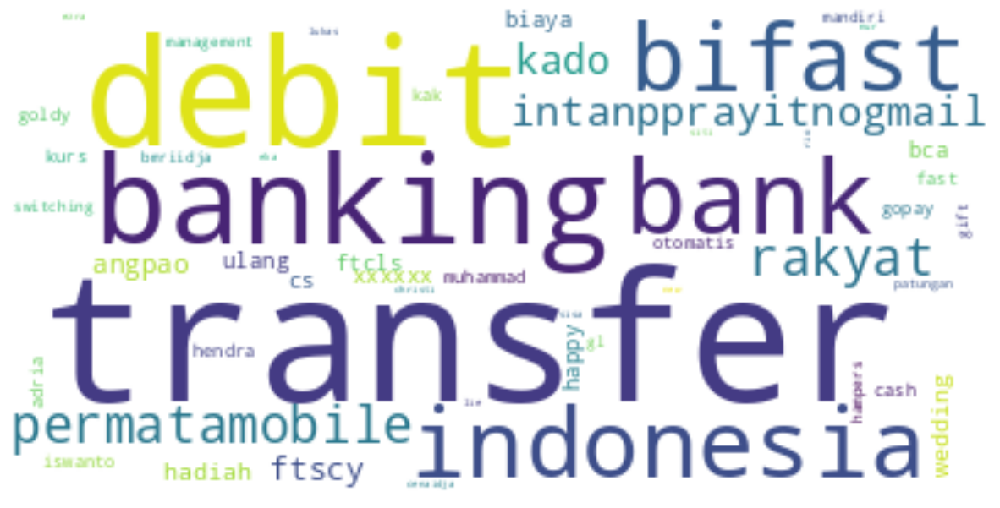

In [98]:
text = ' '.join([text for text in df_hadiah['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [99]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('transfer', 206), ('debit', 130), ('banking', 111), ('bank', 76), ('indonesia', 76), ('bifast', 74), ('permatamobile', 69), ('rakyat', 68), ('intanpprayitnogmail', 61), ('kado', 57)]
[('transfer', 1.0), ('debit', 0.6310679611650486), ('banking', 0.5388349514563107), ('bank', 0.36893203883495146), ('indonesia', 0.36893203883495146), ('bifast', 0.3592233009708738), ('permatamobile', 0.33495145631067963), ('rakyat', 0.3300970873786408), ('intanpprayitnogmail', 0.2961165048543689), ('kado', 0.2766990291262136)]


In [100]:
df_hadiah = df_hadiah[df_hadiah['description'].str.contains('debit|transfer|kado|happy|angpao|gift|patungan')].reset_index(drop=True)

In [101]:
df_hadiah

,description,category
0,transfer banking debit wedding andar enda eva ...,Gifts
1,transfer banking debit carramica gift cipta fa...,Gifts
2,debit otomatis ftcls kurs xxxxxx ulang agus fe...,Gifts
3,transfer banking debit angpao nurul deva kumala,Gifts
4,transfer banking debit angpao wawan putra liowono,Gifts
...,...,...
215,transfer banking debit ftcls xxxxxx ulang yesa...,Gifts
216,transfer banking debit happy wedding ciku binn...,Gifts
217,gopay transfer tegar yasindra hadiah giveaway,Gifts
218,gopay transfer dikaswatans hadiah giveaway,Gifts


## Gas and Fuel

In [102]:
data = df['description'][df['category']=='Gas & Fuel']

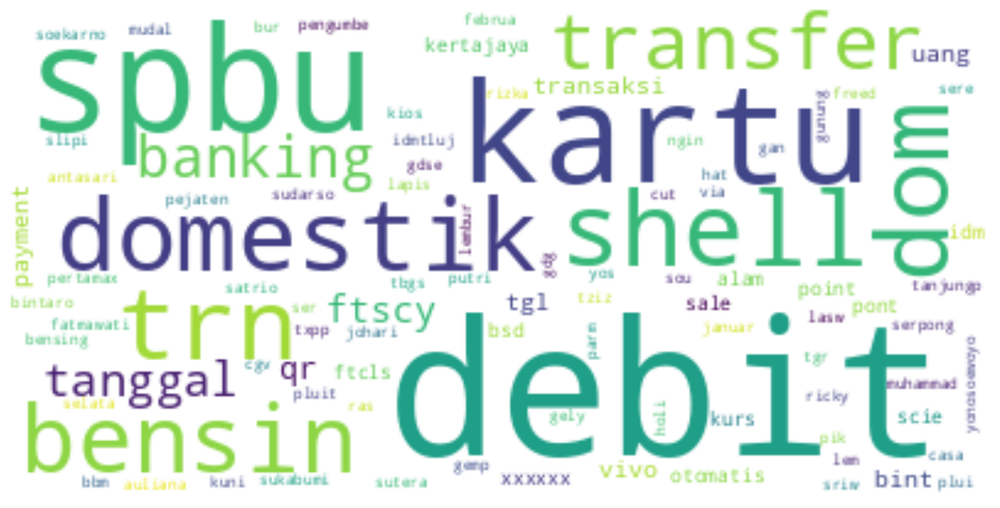

In [103]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [104]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 84), ('spbu', 47), ('kartu', 43), ('shell', 21), ('domestik', 20), ('trn', 20), ('dom', 20), ('bensin', 17), ('transfer', 16), ('banking', 16)]
[('debit', 1.0), ('spbu', 0.5595238095238095), ('kartu', 0.5119047619047619), ('shell', 0.25), ('domestik', 0.23809523809523808), ('trn', 0.23809523809523808), ('dom', 0.23809523809523808), ('bensin', 0.20238095238095238), ('transfer', 0.19047619047619047), ('banking', 0.19047619047619047)]


In [105]:
data = data[data.str.contains('shell|bensin|spbu')].reset_index(drop=True)

In [106]:
data

0                 debit domestik tanggal trn dom spbu
1                 debit domestik tanggal trn dom spbu
2                 debit domestik tanggal trn dom spbu
3            debit domestik tanggal trn dom spbu kuni
4                 debit domestik tanggal trn dom spbu
                           ...                       
80               transfer banking debit ftscy bensing
81                transfer banking debit ftscy bensin
82        transfer banking debit ftscy bensin lem bur
83         transfer banking debit ftscy bensin lembur
84    transfer banking debit ftscy uang bensin februa
Name: description, Length: 85, dtype: object

In [107]:
df_gas = aug_text(data, 'Gas & Fuel')

In [108]:
df_gas

,description,category
0,saldo domestik tanggal trn dom spbu,Gas & Fuel
1,likuiditas domestik tanggal trn dom spbu,Gas & Fuel
2,bandwidth domestik tanggal trn dom spbu,Gas & Fuel
3,genangan domestik tanggal trn dom spbu,Gas & Fuel
4,m³ domestik tanggal trn dom spbu,Gas & Fuel
...,...,...
3895,transfer banking debit ftscy uang turbocharger...,Gas & Fuel
3896,transfer banking debit ftscy uang avtur februa,Gas & Fuel
3897,transfer banking debit ftscy uang bertimbal fe...,Gas & Fuel
3898,transfer banking debit ftscy uang lpg februa,Gas & Fuel


## Gadget & Electronics

In [109]:
data = df['description'][df['category']=='Gadget & Electronics']

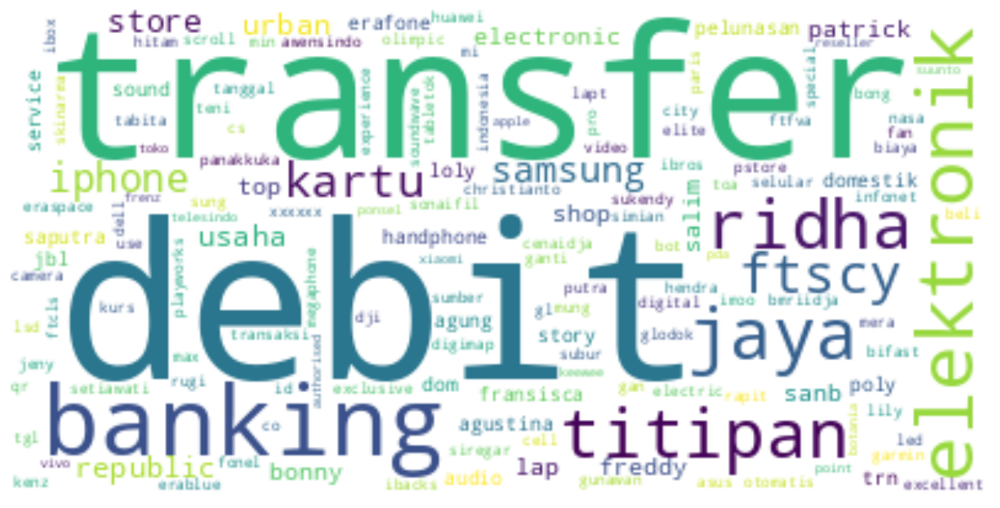

In [110]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [111]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 46), ('transfer', 31), ('banking', 31), ('elektronik', 19), ('jaya', 17), ('titipan', 16), ('ridha', 16), ('ftscy', 15), ('kartu', 11), ('iphone', 8)]
[('debit', 1.0), ('transfer', 0.6739130434782609), ('banking', 0.6739130434782609), ('elektronik', 0.41304347826086957), ('jaya', 0.3695652173913043), ('titipan', 0.34782608695652173), ('ridha', 0.34782608695652173), ('ftscy', 0.32608695652173914), ('kartu', 0.2391304347826087), ('iphone', 0.17391304347826086)]


In [112]:
data = data[data.str.contains('elektronik|electronic|samsung|iphone|handphone')].reset_index(drop=True)

In [113]:
data

0                        kartu debit nasa samsung store
1        transfer banking debit ftscy handphone samsung
2              transfer banking debit ftscy led samsung
3     debit otomatis ftcls kurs xxxxxx iphone tabita...
4                         kartu debit glodok elektronik
5                        kartu debit olimpic elektronik
6                          kartu debit paris elektronik
7                           samsung hitam rapit gunawan
8     transfer banking debit titipan ridha jaya elek...
9                         transfer banking debit iphone
10    transfer banking debit titipan ridha jaya elek...
11    transfer banking debit titipan ridha jaya elek...
12    transfer banking debit titipan ridha jaya elek...
13              transfer banking debit iphone jeny sung
14                transfer banking debit service iphone
15    transfer banking debit titipan ridha jaya elek...
16    transfer banking debit ftscy pelunasan iphone ...
17    transfer banking debit titipan ridha jaya 

In [114]:
df_gadget= aug_text(data, 'Gadget & Electronics')

In [115]:
df_gadget

,description,category
0,card debit nasa samsung store,Gadget & Electronics
1,token debit nasa samsung store,Gadget & Electronics
2,paspor debit nasa samsung store,Gadget & Electronics
3,voucher debit nasa samsung store,Gadget & Electronics
4,kotak debit nasa samsung store,Gadget & Electronics
...,...,...
2305,consumer,Gadget & Electronics
2306,alcatel,Gadget & Electronics
2307,automotive,Gadget & Electronics
2308,pentax,Gadget & Electronics


## Service & Auto Parts

In [116]:
data = df['description'][df['category']=='Service & Auto Parts']

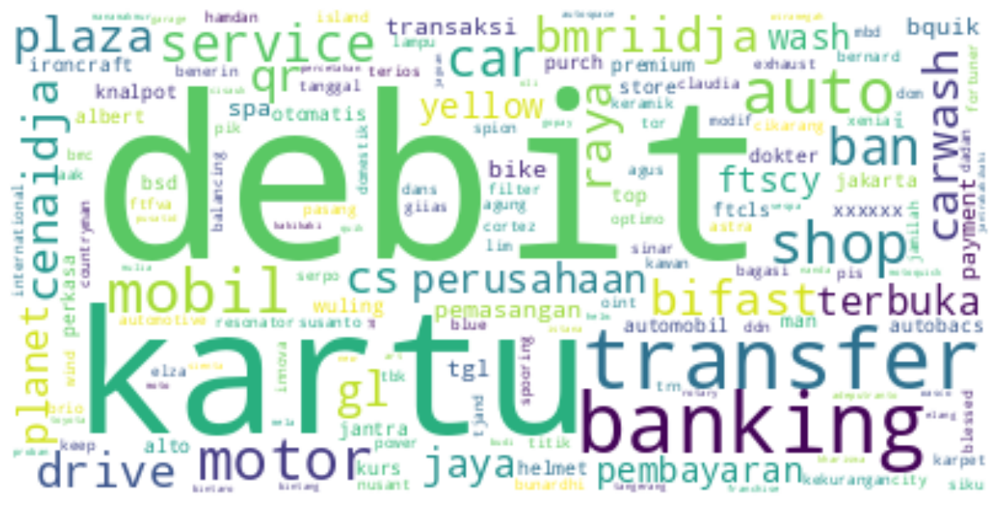

In [117]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [118]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 54), ('kartu', 28), ('transfer', 20), ('banking', 20), ('auto', 10), ('mobil', 9), ('shop', 8), ('motor', 8), ('car', 6), ('service', 6)]
[('debit', 1.0), ('kartu', 0.5185185185185185), ('transfer', 0.37037037037037035), ('banking', 0.37037037037037035), ('auto', 0.18518518518518517), ('mobil', 0.16666666666666666), ('shop', 0.14814814814814814), ('motor', 0.14814814814814814), ('car', 0.1111111111111111), ('service', 0.1111111111111111)]


In [119]:
data = data[data.str.contains('motor|mobil|ban|carwash')].reset_index(drop=True)

In [120]:
data

0              debit otomatis ftcls kurs xxxxxx carwash
1      debit otomatis tanggal ftcls kurs xxxxxx carwash
2                        kartu debit yellow carwash pik
3                        kartu debit dokter mobil serpo
4                            kartu debit yellow carwash
5              pemasangan lampu dans motor dadan hamdan
6                     transfer banking debit mobil brio
7                          transfer banking debit mobil
8     transfer banking debit mbd albert plaza auto r...
9     transfer banking debit spion countryman plaza ...
10    transfer banking debit mobil terios titik bern...
11    transfer banking debit plaza auto raya perusah...
12    transfer banking debit service cortez automobi...
13            transfer banking debit spooring balancing
14    transfer banking debit benerin mobil agus susa...
15      transfer banking debit mobil claudia elza tjand
16    transfer banking debit siku mobil pis keramik ...
17    transfer banking debit karpet bagasi plaza

In [121]:
df_serpis= aug_text(data, 'Service & Auto Parts')

In [122]:
df_serpis

,description,category
0,saldo otomatis ftcls kurs xxxxxx carwash,Service & Auto Parts
1,likuiditas otomatis ftcls kurs xxxxxx carwash,Service & Auto Parts
2,bandwidth otomatis ftcls kurs xxxxxx carwash,Service & Auto Parts
3,genangan otomatis ftcls kurs xxxxxx carwash,Service & Auto Parts
4,m³ otomatis ftcls kurs xxxxxx carwash,Service & Auto Parts
...,...,...
2255,pdc carwash tunai,Service & Auto Parts
2256,pdc carwash pelunasan,Service & Auto Parts
2257,pdc carwash pembiayaan,Service & Auto Parts
2258,pdc carwash pembelian,Service & Auto Parts


## Entertainment

In [123]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Hiburan'].reset_index(drop=True).apply(lambda x: general(x))

In [124]:
df_hiburan = pd.DataFrame({'description':data, 'category':['Entertainment']*len(data)})

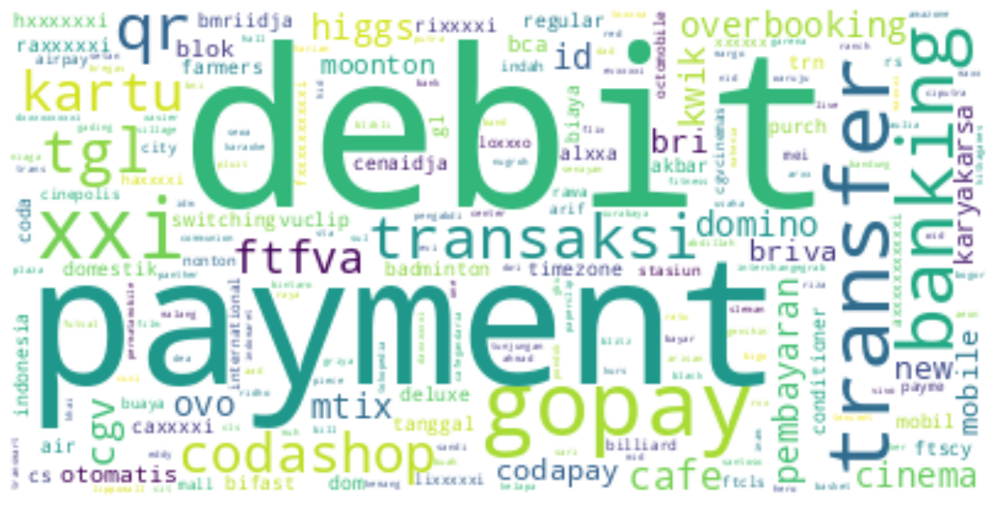

In [125]:
text = ' '.join([text for text in df_hiburan['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [126]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 741), ('payment', 472), ('gopay', 449), ('transfer', 414), ('xxi', 368), ('banking', 316), ('qr', 213), ('transaksi', 186), ('tgl', 184), ('codashop', 171)]
[('debit', 1.0), ('payment', 0.6369770580296896), ('gopay', 0.6059379217273954), ('transfer', 0.5587044534412956), ('xxi', 0.4966261808367072), ('banking', 0.42645074224021595), ('qr', 0.2874493927125506), ('transaksi', 0.25101214574898784), ('tgl', 0.2483130904183536), ('codashop', 0.23076923076923078)]


In [127]:
df_hiburan[df_hiburan['description'].str.contains('higgs')]

,description,category
56,gopay payment codashop higgs domino dea nbukgdlid,Entertainment
228,gopay payment codashop higgs domino fya pacegfid,Entertainment
229,gopay payment codashop higgs domino adba avrcl...,Entertainment
230,gopay payment codashop higgs domino bgxid,Entertainment
231,gopay payment codashop higgs domino gvvxulgop id,Entertainment
...,...,...
1227,gopay payment codapay higgs domino bkn id,Entertainment
1228,gopay payment codapay higgs domino cad fpcw wid,Entertainment
1229,gopay payment codapay higgs domino aeab ede nc...,Entertainment
1230,gopay payment codapay higgs domino dhfmqyfhuid,Entertainment


In [128]:
df_hiburan = df_hiburan[df_hiburan['description'].str.contains('xxi|cinema|timezone|cgvcinemas|cinepolis|billiard|cgv|mtix|codashop|higgs')].reset_index(drop=True)

In [129]:
df_hiburan

,description,category
0,gopay payment tokopedia kasbohlqxxid,Entertainment
1,transaksi debit tgl qr xxi cafe,Entertainment
2,debit interchange cgv,Entertainment
3,gopay payment xxi cambridge city square fdc ea...,Entertainment
4,transfer banking debit ftcls xxxxxx mike billi...,Entertainment
...,...,...
932,transfer banking debit ftfva xxi mtix,Entertainment
933,overbooking kwik transfer ovo lixxxxxi loxxxo,Entertainment
934,transaksi debit tgl qr timezone,Entertainment
935,transaksi debit tgl qr timezone,Entertainment


## Travel

In [130]:
data = df['description'][df['category']=='Travel']

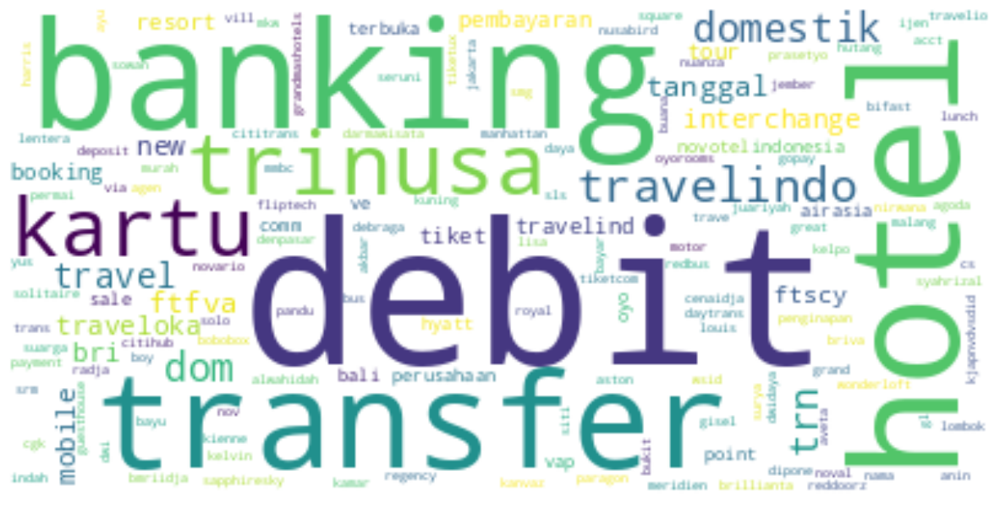

In [131]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [132]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 51), ('banking', 27), ('hotel', 27), ('transfer', 26), ('trinusa', 17), ('kartu', 15), ('travelindo', 14), ('domestik', 10), ('trn', 10), ('dom', 10)]
[('debit', 1.0), ('banking', 0.5294117647058824), ('hotel', 0.5294117647058824), ('transfer', 0.5098039215686274), ('trinusa', 0.3333333333333333), ('kartu', 0.29411764705882354), ('travelindo', 0.27450980392156865), ('domestik', 0.19607843137254902), ('trn', 0.19607843137254902), ('dom', 0.19607843137254902)]


In [133]:
data = data[data.str.contains('tiket|traveloka|hotel|resort')].reset_index(drop=True)

In [134]:
data

0                  bayar via banking wsid traveloka com
1             debit domestik tanggal trn dom lisa hotel
2       debit domestik tanggal trn dom ijen resort vill
3             debit domestik trn dom hotel great dipone
4                   debit domestik trn dom resort hotel
5                       debit interchange hotel booking
6                   debit interchange tanggal traveloka
7                           debit interchange tiket com
8                           debit interchange traveloka
9     transfer new bri mobile banking hotel murah trave
10                     ve point sale comm vap traveloka
11              briva new bri mobile banking oyo hotels
12                 debit domestik trn dom resort suarga
13                            kartu debit hotel debraga
14                             kartu debit nuanza hotel
15                       kartu debit louis kienne hotel
16                       kartu debit hotel royal kuning
17                        kartu debit sapphiresk

In [135]:
df_travel= aug_text(data, 'Travel')

In [136]:
df_travel

,description,category
0,cicilan via banking wsid traveloka com,Travel
1,menagih via banking wsid traveloka com,Travel
2,membayar via banking wsid traveloka com,Travel
3,pembayaran via banking wsid traveloka com,Travel
4,melunasi via banking wsid traveloka com,Travel
...,...,...
1835,transfer banking pengaliran ftfva tiketux,Travel
1836,transfer banking neraca ftfva tiketux,Travel
1837,transfer banking tagihan ftfva tiketux,Travel
1838,transfer banking pengeluaran ftfva tiketux,Travel


## Donation & Social

In [137]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Donasi'].reset_index(drop=True).apply(lambda x: general(x))

In [138]:
df_donasi = pd.DataFrame({'description':data, 'category':['Donation & Social']*len(data)})

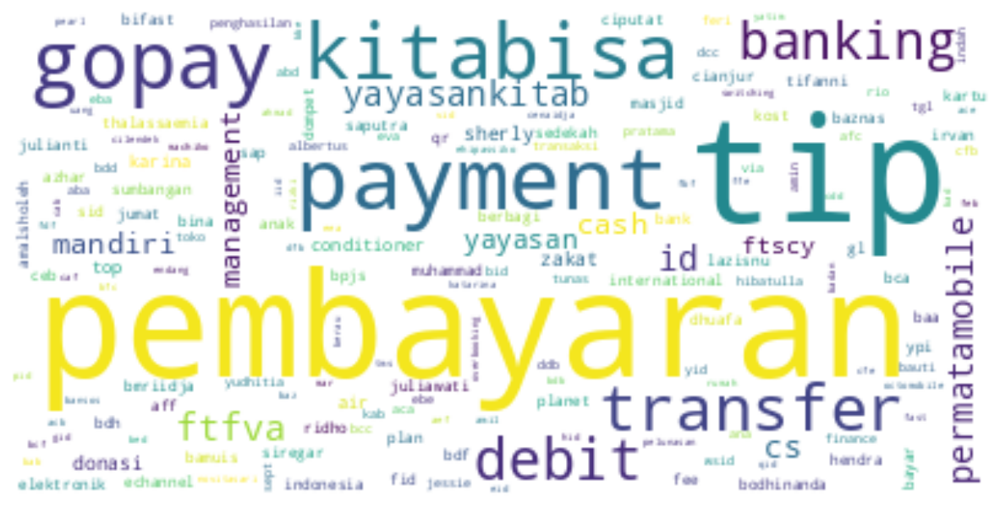

In [139]:
text = ' '.join([text for text in df_donasi['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [140]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('tip', 2352), ('pembayaran', 2350), ('payment', 632), ('gopay', 530), ('kitabisa', 505), ('transfer', 327), ('debit', 264), ('banking', 227), ('ftfva', 107), ('yayasankitab', 94)]
[('tip', 1.0), ('pembayaran', 0.9991496598639455), ('payment', 0.2687074829931973), ('gopay', 0.22534013605442177), ('kitabisa', 0.2147108843537415), ('transfer', 0.13903061224489796), ('debit', 0.11224489795918367), ('banking', 0.09651360544217687), ('ftfva', 0.04549319727891157), ('yayasankitab', 0.039965986394557826)]


In [141]:
df_donasi[df_donasi['description'].str.contains('dompet')]

,description,category
455,dompet dhuafa pembayaran,Donation & Social
700,transfer banking debit ftscy cicilan mobil dom...,Donation & Social
750,switching debit biaya transfer yayasan dompet ...,Donation & Social
751,switching debit transfer yayasan dompet dhuafa...,Donation & Social
1350,gopay payment dompet dhuafa air conditioner pl...,Donation & Social
1930,transfer banking debit ftscy infaq erry brian ...,Donation & Social
2794,transfer banking debit ftfva dompet dhuaf,Donation & Social
2795,gopay payment dompet dhuafa jbp inkuuid,Donation & Social
3220,yayasan dompet dhuafa pembayaran,Donation & Social
3221,yayasan dompet dhuafa pembayaran,Donation & Social


In [142]:
df_donasi = df_donasi[df_donasi['description'].str.contains('kitabisa|yayasankitab|dhuafa|amalsholeh|berbagi|masjid|gereja|sumbangan|dompet')].reset_index(drop=True)

In [143]:
df_donasi = df_donasi.iloc[0:1000]

In [144]:
df_donasi

,description,category
0,transfer banking debit ftfva yayasankitab,Donation & Social
1,gopay payment amalsholeh com fced dcc efuaan id,Donation & Social
2,gopay payment amalsholeh com feadb cfb yplu fi...,Donation & Social
3,gopay payment amalsholeh com bed ygdjl nyxyid,Donation & Social
4,gopay payment amalsholeh com air conditioner d...,Donation & Social
...,...,...
634,transfer banking debit ftfva yayasankitab,Donation & Social
635,gopay payment kitabisa com dea kayunc qvwid,Donation & Social
636,gopay payment kitabisa com bdce baa gyd mkdzktid,Donation & Social
637,gopay payment kitabisa com eec bba eca bad sus...,Donation & Social


## Fees & Charges

In [145]:
data = df['description'][df['category']=='Fees & Charges']

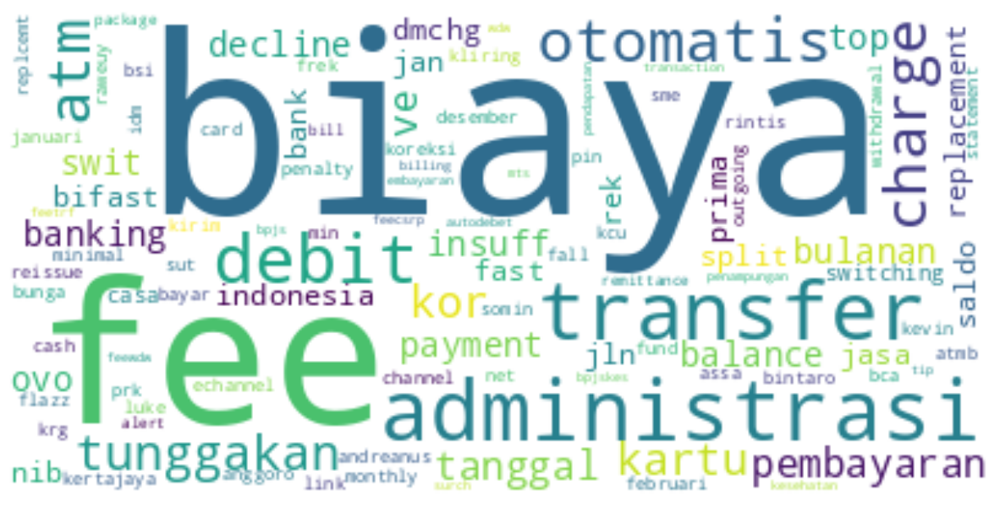

In [146]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [147]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('biaya', 36), ('fee', 20), ('administrasi', 19), ('transfer', 18), ('debit', 13), ('otomatis', 10), ('atm', 9), ('charge', 9), ('tunggakan', 6), ('kartu', 5)]
[('biaya', 1.0), ('fee', 0.5555555555555556), ('administrasi', 0.5277777777777778), ('transfer', 0.5), ('debit', 0.3611111111111111), ('otomatis', 0.2777777777777778), ('atm', 0.25), ('charge', 0.25), ('tunggakan', 0.16666666666666666), ('kartu', 0.1388888888888889)]


In [148]:
data = data[data.str.contains('fee|tunggakan|biaya|administrasi')].reset_index(drop=True)

In [149]:
data

0                            biaya administrasi
1                             biaya bulanan atm
2          biaya administrasi bulanan tunggakan
3                               atm decline fee
4     atm decline fee idm raweuy insuff balance
                        ...                    
61                            pembayaran feewdw
62                           pembayaran fee wdw
63                            pembayaran feetrf
64                      pembayaran fee transfer
65                            embayaran feecsrp
Name: description, Length: 66, dtype: object

In [150]:
df_fee= aug_text(data, 'Fees & Charges')

In [151]:
df_fee

,description,category
0,ongkos administrasi,Fees & Charges
1,biayanya administrasi,Fees & Charges
2,anggaran administrasi,Fees & Charges
3,pengeluaran administrasi,Fees & Charges
4,tarif administrasi,Fees & Charges
...,...,...
2465,pembayaran fee ditransfer,Fees & Charges
2466,pembayaran fee fee,Fees & Charges
2467,pembayaran fee pengembalian,Fees & Charges
2468,pembayaran fee pembayaran,Fees & Charges


## Kids

In [152]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Kebutuhan Anak'].reset_index(drop=True).apply(lambda x: general(x))

In [153]:
df_kids = pd.DataFrame({'description':data, 'category':['Kids']*len(data)})

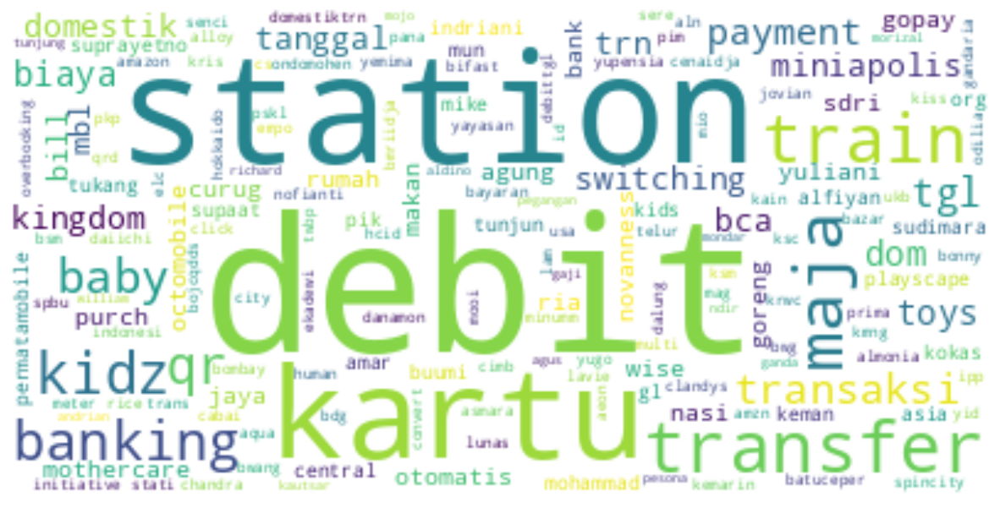

In [154]:
text = ' '.join([text for text in df_kids['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [155]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 61), ('station', 39), ('kartu', 25), ('transfer', 24), ('train', 23), ('maja', 22), ('kidz', 15), ('banking', 14), ('qr', 13), ('baby', 11)]
[('debit', 1.0), ('station', 0.639344262295082), ('kartu', 0.4098360655737705), ('transfer', 0.39344262295081966), ('train', 0.3770491803278688), ('maja', 0.36065573770491804), ('kidz', 0.2459016393442623), ('banking', 0.22950819672131148), ('qr', 0.21311475409836064), ('baby', 0.18032786885245902)]


In [156]:
len(df_kids)

101

In [157]:
df_kids[df_kids['description'].str.contains('qr')]

,description,category
2,transaksi debit tgl qr baby rice,Kids
3,bill payment octomobile purch qr toys kingdom ...,Kids
4,bill payment octomobile purch qr toys kingdom ...,Kids
9,transaksi debit tgl qr baby wise,Kids
22,qr payment kids station pskl ksc,Kids
25,transaksi debit tgl qr baby,Kids
33,transaksi debit tgl qr baby wise,Kids
66,transaksi debittgl qr multi toys,Kids
70,overbooking octomobile purch qrd qr off spbu g...,Kids
73,transaksi debit tgl qr kidz stati,Kids


In [158]:
df_kids = df_kids[df_kids['description'].str.contains('baby|mothercare|playscape|kidz')].reset_index(drop=True)

In [159]:
df_kids

,description,category
0,transaksi debit tgl qr baby rice,Kids
1,transfer baby indriani bank central asia perma...,Kids
2,transfer baby indriani bank central asia perma...,Kids
3,transaksi debit tgl qr baby wise,Kids
4,kartu debit buumi playscape,Kids
5,kartu debit buumi playscape,Kids
6,kartu debit kidz station kokas,Kids
7,kartu debit kidz station senci,Kids
8,kartu debit kidz station kokas,Kids
9,kartu debit hokkaido baby,Kids


## Shopping

In [160]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Belanja Bulanan'].reset_index(drop=True).apply(lambda x: general(x))

In [161]:
df_belanja = pd.DataFrame({'description':data, 'category':['Shopping']*len(data)})

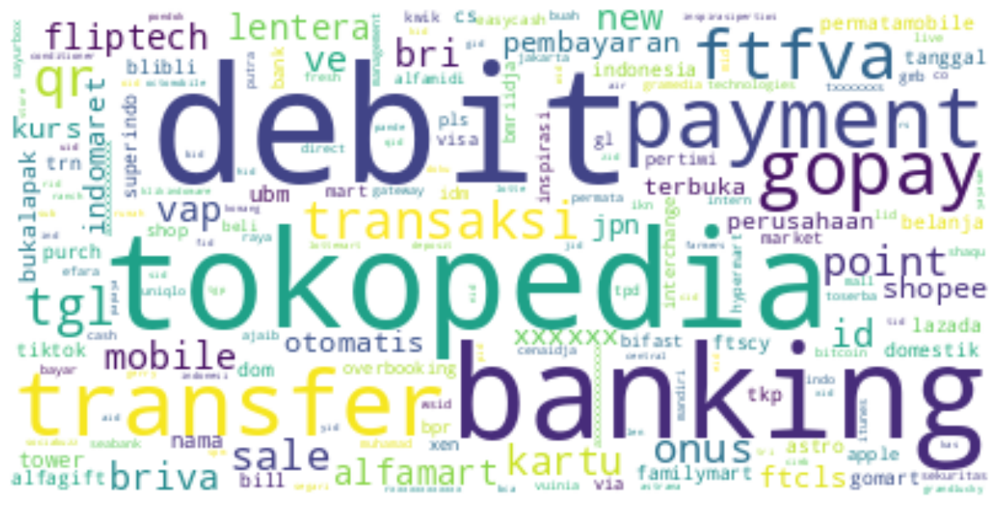

In [162]:
text = ' '.join([text for text in df_belanja['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [163]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 21775), ('tokopedia', 15451), ('banking', 14776), ('transfer', 13381), ('payment', 12044), ('gopay', 11539), ('ftfva', 9244), ('qr', 5287), ('transaksi', 5019), ('tgl', 5012)]
[('debit', 1.0), ('tokopedia', 0.7095752009184845), ('banking', 0.6785763490241102), ('transfer', 0.61451205510907), ('payment', 0.5531113662456946), ('gopay', 0.5299196326061998), ('ftfva', 0.42452353616532723), ('qr', 0.24280137772675087), ('transaksi', 0.23049368541905854), ('tgl', 0.23017221584385764)]


In [164]:
df['description'][df['category']=='Groceries & General'][0:100]

68                  bayar via banking wsid klik indomaret
105     debit domestik tanggal trn dom transmart emporium
120           debit domestik tanggal trn dom alfamart mbl
203           debit domestik tanggal trn dom alfamart mbl
257                   debit domestik trn dom kemchick pik
                              ...                        
2316                                 kartu debit rinimart
2322                       kartu debit sakura mart pesona
2325                                kartu debit smart way
2331                              kartu debit susana mart
2339                            kartu debit wan hypermall
Name: description, Length: 100, dtype: object

In [165]:
df_belanja[df_belanja['description'].str.contains('go')]

,description,category
0,gopay payment tokopedia qrnk fdid,Shopping
1,gopay payment tokopedia xofhel hgdid,Shopping
2,gopay payment tokopedia vwwcbngb pid,Shopping
3,gopay payment indomaret rxgp szdedid,Shopping
4,gopay payment indomaret wkr viid,Shopping
...,...,...
43694,gopay payment farmers market niaga yxdaq uyutid,Shopping
43695,gopay payment tokopedia knmuwxqhvaid,Shopping
43696,gopay payment tokopedia ndabgkdid,Shopping
43697,gopay payment tokopedia octoruoxfgid,Shopping


In [166]:
df_belanja = df_belanja[df_belanja['description'].str.contains('ftva|bukalapak|tokopedia|lazada|blibli|belanja|shopee')].reset_index(drop=True)

In [167]:
df_belanja = df_belanja[0:1000]

In [168]:
df_belanja

,description,category
0,gopay payment tokopedia qrnk fdid,Shopping
1,gopay payment tokopedia xofhel hgdid,Shopping
2,gopay payment tokopedia vwwcbngb pid,Shopping
3,gopay payment tokopedia hbrk zid,Shopping
4,gopay payment tokopedia bpkehhhrycid,Shopping
...,...,...
995,transfer banking debit ftfva tokopedia,Shopping
996,transfer banking debit ftfva tokopedia,Shopping
997,gopay payment tokopedia tvmereatjid,Shopping
998,gopay payment tokopedia kdjwctuwsid,Shopping


## Top Up

In [169]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Top Up E-Wallet'].reset_index(drop=True).apply(lambda x: general(x))

In [170]:
df_top = pd.DataFrame({'description':data, 'category':['Top Up']*len(data)})

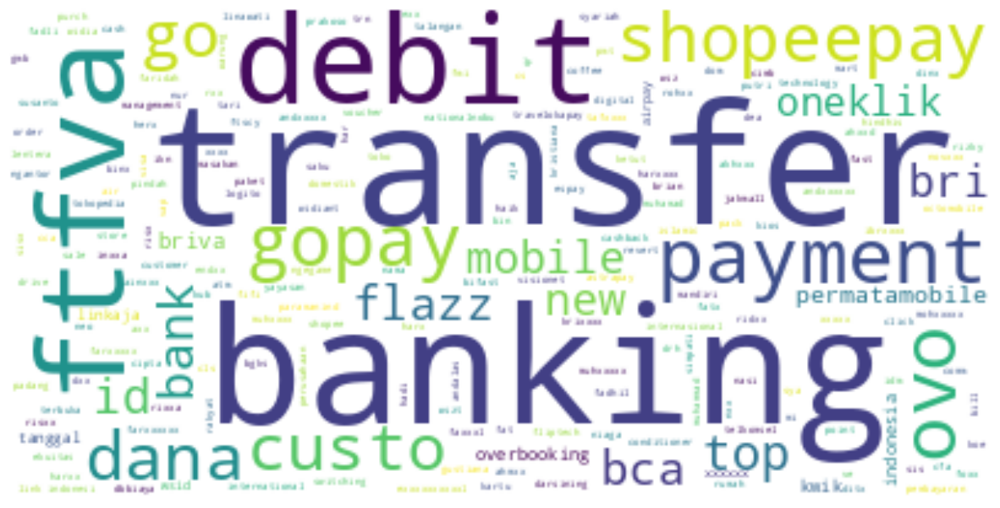

In [171]:
text = ' '.join([text for text in df_top['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [172]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('transfer', 22396), ('banking', 20469), ('debit', 19045), ('ftfva', 18547), ('payment', 5888), ('ovo', 5473), ('gopay', 4928), ('shopeepay', 4856), ('go', 4545), ('custo', 4537)]
[('transfer', 1.0), ('banking', 0.9139578496160029), ('debit', 0.8503750669762458), ('ftfva', 0.8281389533845329), ('payment', 0.2629040900160743), ('ovo', 0.24437399535631363), ('gopay', 0.2200392927308448), ('shopeepay', 0.21682443293445258), ('go', 0.20293802464725844), ('custo', 0.20258081800321487)]


In [173]:
df['description'][df['category']=='Top Up'][0:50]

3                        briva new bri mobile banking ovo
4               briva new bri mobile banking dana binxxxx
5       briva new bri mobile banking link aja custom c...
17                                      pembayaran top up
350                              flazz bca tanggal top up
351                         flazz bca tanggal top up wsid
352                             flazz bca top up alfamart
353                             flazz bca top up alfamart
354                              flazz bca top up fmi mrt
355                          flazz bca top up fmi revenue
356                                      flazz bca top up
357              islamic banking pmt ovo wixx auxxxxxxxxx
358                 islamic banking pmt ovo faxxr maxxxxa
359                 islamic banking pmt ovo saxxxa adxxxa
360                        islamic banking pmt ovo raxxxa
908                              uangku smartfren telecom
909                                         uangku top up
937           

In [174]:
df_top[df_top['description'].str.contains('uangku')]

,description,category
24221,transfer banking debit ftscy top up uangku sma...,Top Up


In [175]:
df_top = df_top[df_top['description'].str.contains('top|unipin|ovo|dana|gopay|shopeepay')].reset_index(drop=True)

In [176]:
df_top = df_top[0:1000]

In [177]:
df_top

,description,category
0,overbooking kwik transfer ovo raxx saxxxxa,Top Up
1,overbooking octomobile transfer ovo ahxxd rixx...,Top Up
2,purch visa dana id,Top Up
3,payment shopeepay permatamobile,Top Up
4,transfer banking debit ftfva ovo,Top Up
...,...,...
995,transfer banking debit ftfva dana,Top Up
996,transfer banking debit ftfva dana,Top Up
997,transfer banking debit ftfva dana,Top Up
998,transfer banking debit ftfva ovo,Top Up


## Household Tools

In [178]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Kebutuhan Rumah Tangga'].reset_index(drop=True).apply(lambda x: general(x))

In [179]:
df_household = pd.DataFrame({'description':data, 'category':['Household Tools']*len(data)})

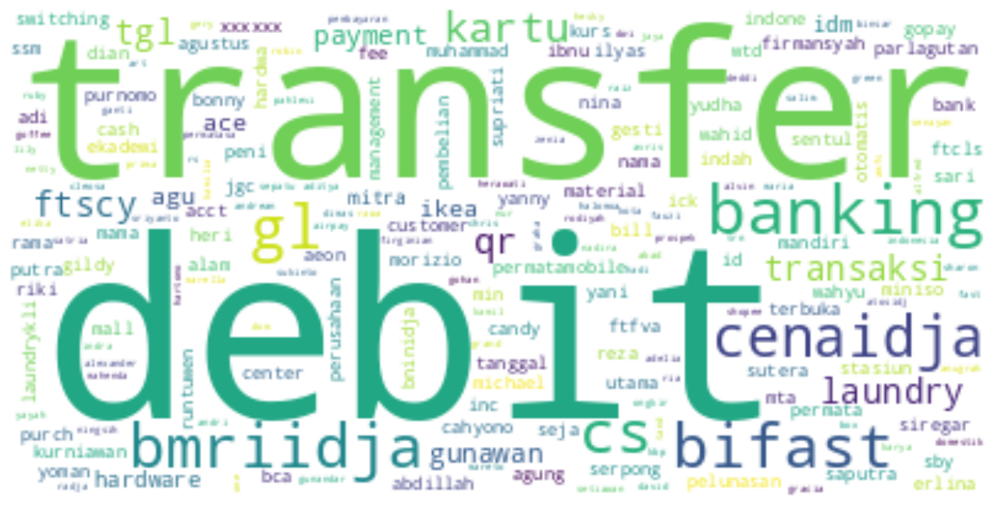

In [180]:
text = ' '.join([text for text in df_household['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [181]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 1303), ('transfer', 815), ('banking', 744), ('cs', 659), ('bifast', 650), ('gl', 648), ('bmriidja', 637), ('cenaidja', 613), ('kartu', 287), ('qr', 224)]
[('debit', 1.0), ('transfer', 0.6254796623177283), ('banking', 0.5709900230237912), ('cs', 0.5057559478127398), ('bifast', 0.49884881043745205), ('gl', 0.49731389102072143), ('bmriidja', 0.488871834228703), ('cenaidja', 0.47045280122793554), ('kartu', 0.2202609363008442), ('qr', 0.17191097467382963)]


In [182]:
df['description'][df['category']=='Household Tools'][0:50]

115                 debit domestik tanggal trn dom ikea
235                    debit domestik trn dom ikea bali
413                            kartu debit ace hardware
544                        kartu debit ace xpress graha
779                                    kartu debit onna
1336                       transaksi debit tgl qr mitra
1339                  transaksi debit tgl qr ace hardwa
1624            transfer banking debit onna prima utama
1671    transfer banking debit ftscy oven listrik sharp
1687           transfer banking debit ftfva home center
2020                                   kartu debit ikea
2589         transfer banking debit vas ikea firmansyah
2861          transfer banking debit ftfva ikea indones
3149          transfer banking debit ftscy rumah tangga
3258                                ruparupa pembayaran
3259                         gopay payment ruparupa com
3260                                kartu debit informa
3261                                 informa pem

In [183]:
df_household[df_household['description'].str.contains('transfer')]

,description,category
7,transfer banking debit herman wilianto,Household Tools
20,transfer banking debit nambahi nyawe cewex har...,Household Tools
21,transfer banking debit laundry suherman,Household Tools
22,transfer banking debit laundry suherman,Household Tools
23,transfer banking debit laundry cleosa marella,Household Tools
...,...,...
2151,transfer banking debit ftscy sucipto gunawan,Household Tools
2158,transfer banking debit ftscy kurangnya ick sby...,Household Tools
2159,transfer banking debit ftscy wtd ick sby yanny,Household Tools
2162,transfer banking debit mama uuk sgd ishak reza,Household Tools


In [184]:
df_household = df_household[df_household['description'].str.contains('ikea|miniso|ace')].reset_index(drop=True)

In [185]:
df_household

,description,category
0,kartu debit ikea mta,Household Tools
1,gopay payment ace hardware lotte shopping aven...,Household Tools
2,kartu debit ikea jgc,Household Tools
3,gopay payment ikea fee odmodgsre id,Household Tools
4,kartu debit ace hardware ibcc,Household Tools
...,...,...
239,transaksi debit tgl qr ikea jgc,Household Tools
240,kartu debit ikea mta,Household Tools
241,kartu debit ace hardware ganda,Household Tools
242,kartu debit ace grand batam,Household Tools


## Transport

In [186]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Transportasi'].reset_index(drop=True).apply(lambda x: general(x))

In [187]:
df_trans = pd.DataFrame({'description':data, 'category':['Transport']*len(data)})

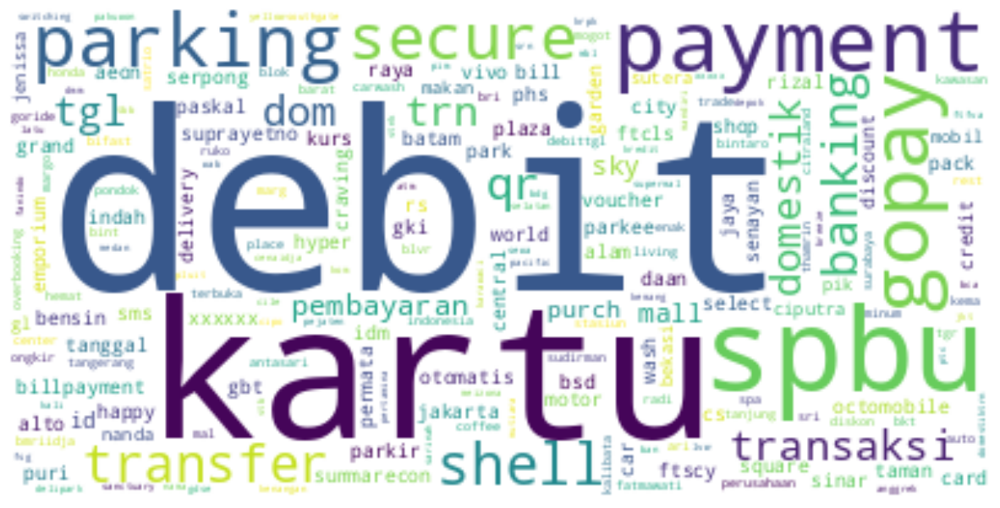

In [188]:
text = ' '.join([text for text in df_trans['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [189]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 1649), ('kartu', 865), ('spbu', 863), ('payment', 832), ('gopay', 708), ('parking', 670), ('secure', 501), ('shell', 394), ('transfer', 342), ('banking', 323)]
[('debit', 1.0), ('kartu', 0.5245603395997575), ('spbu', 0.5233474833232262), ('payment', 0.5045482110369921), ('gopay', 0.42935112189205576), ('parking', 0.4063068526379624), ('secure', 0.30382049727107335), ('shell', 0.23893268647665253), ('transfer', 0.20739842328684052), ('banking', 0.1958762886597938)]


In [190]:
df['description'][df['category']=='Service & Auto Parts'][0:50]

42      bifast out cs gl bmriidja cenaidja pemasangan ...
43      bifast out cs gl bmriidja cenaidja pemasangan ...
47      bifast out cs gl bmriidja cenaidja kekurangan ...
48      bifast out cs gl bmriidja cenaidja pasang knal...
316              debit otomatis ftcls kurs xxxxxx carwash
337      debit otomatis tanggal ftcls kurs xxxxxx carwash
438                          kartu debit premium car wash
440                        kartu debit yellow carwash pik
511                                  kartu debit auto spa
553                             kartu debit auto bsd city
554                                      kartu debit auto
555                            kartu debit autobacs store
556                        kartu debit autobacs store bsd
590                        kartu debit blessed auto modif
649                        kartu debit dokter mobil serpo
719                              kartu debit out car wash
780                         kartu debit optimo automotive
789           

In [191]:
df_trans[df_trans['description'].str.contains('auto')]

,description,category
164,kartu debit elgaya auto care,Transport
165,kartu debit elgaya auto care,Transport
188,kartu debit auto accesories,Transport
568,kartu debit auto glaze,Transport
974,transfer banking debit parama sutera auto,Transport
1257,transfer banking debit ericrush perusahaan ter...,Transport
1258,transfer banking debit ericrush perusahaan ter...,Transport
1259,transfer banking debit ericrush perusahaan ter...,Transport
1407,transaksi debittgl qr akaze auto,Transport
1416,auto adjustments refund,Transport


In [192]:
df_trans = df_trans[df_trans['description'].str.contains('parking|secure|auto')].reset_index(drop=True)

In [193]:
df_trans

,description,category
0,gopay payment secure parking central park kcdo...,Transport
1,gopay payment secure parking central park kacn...,Transport
2,gopay payment secure parking central park jcis...,Transport
3,gopay payment secure parking central park jcis...,Transport
4,sky parking pembayaran,Transport
...,...,...
683,gopay payment secure parking sarinah thamrin s...,Transport
684,gopay payment secure parking senayan city jcjr...,Transport
685,sky parking pembayaran,Transport
686,gopay payment secure parking ciputra world jak...,Transport


## Insurance

In [194]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Asuransi'].reset_index(drop=True).apply(lambda x: general(x))

In [195]:
df_asu = pd.DataFrame({'description':data, 'category':['Insurance']*len(data)})

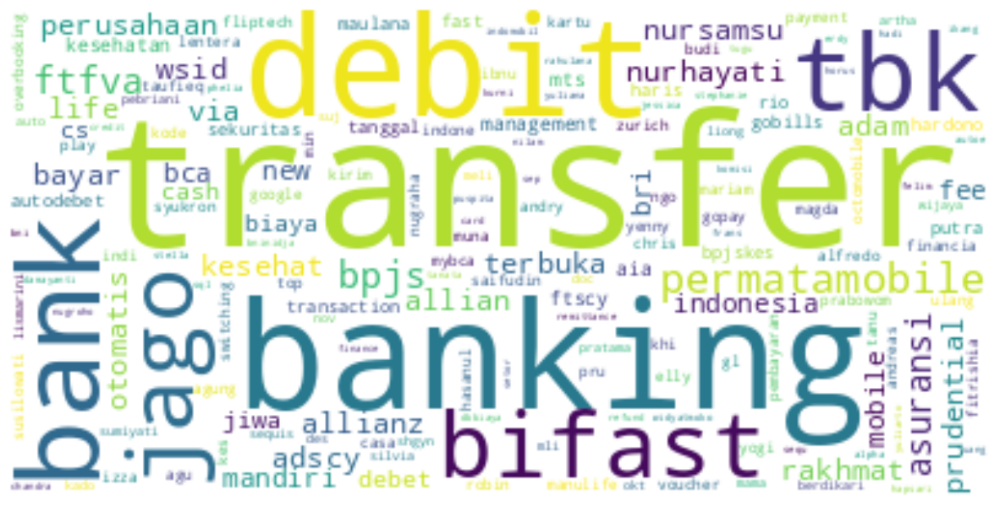

In [196]:
text = ' '.join([text for text in df_asu['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [197]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('transfer', 742), ('banking', 491), ('debit', 429), ('bank', 278), ('tbk', 247), ('bifast', 246), ('jago', 244), ('permatamobile', 244), ('ftfva', 190), ('bpjs', 185)]
[('transfer', 1.0), ('banking', 0.6617250673854448), ('debit', 0.578167115902965), ('bank', 0.3746630727762803), ('tbk', 0.3328840970350404), ('bifast', 0.33153638814016173), ('jago', 0.3288409703504043), ('permatamobile', 0.3288409703504043), ('ftfva', 0.2560646900269542), ('bpjs', 0.24932614555256064)]


In [198]:
df['description'][df['category']=='Insurance'][0:50]

55                      bayar via banking wsid prudential
56           gobills prudential premi kontribusi lanjutan
84             bayar via banking tanggal wsid sequis life
327     debit otomatis asuransi perusahaan terbuka allian
343                          debet setor dplk mobile bank
344     debet otomatis asuransi perusahaan terbuka allian
867                      dec sun life financial indonesia
868                                          surat bpjstk
869                               blse bni life insurance
870                                                bpjstk
887                  mli asuransi jiwa manulife indonesia
932     mts casa gl perusahaan terbuka asuransi allian...
1461                 transfer bpjs new bri mobile banking
1469    transfer dplk perusahaan terbuka bni persero t...
1505                      transfer banking debit asuransi
1520    transfer banking debit manulife sukuj inklusi ...
1553              transfer banking debit asuransi allianz
1562          

In [199]:
df_asu[df_asu['description'].str.contains('financial')]

,description,category
344,mandiri cash management transfer cs aug sun li...,Insurance
404,transfer banking debit adscy axa financial indo,Insurance


In [200]:
df_asu = df_asu[df_asu['description'].str.contains('bpjs|life|asuransi|prudential|financial')].reset_index(drop=True)

In [201]:
df_asu

,description,category
0,transfer banking debit ftfva bpjs kesehat,Insurance
1,transfer banking debit ftfva bpjs kesehat,Insurance
2,transfer banking debit adscy bpjs kes,Insurance
3,bpjs kesehatan pembayaran,Insurance
4,transfer banking debit ftfva bpjs kesehat,Insurance
...,...,...
519,bayar via banking wsid prudential hendrik wijaya,Insurance
520,bayar via banking wsid prudential hendrik wijaya,Insurance
521,gopay payment life game pwwmid,Insurance
522,transfer banking debit ftfva bpjs kesehat,Insurance


## Subscription

In [202]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Langganan (Netflix, Spotify, dll)'].reset_index(drop=True).apply(lambda x: general(x))

In [203]:
df_subs = pd.DataFrame({'description':data, 'category':['Subscription']*len(data)})

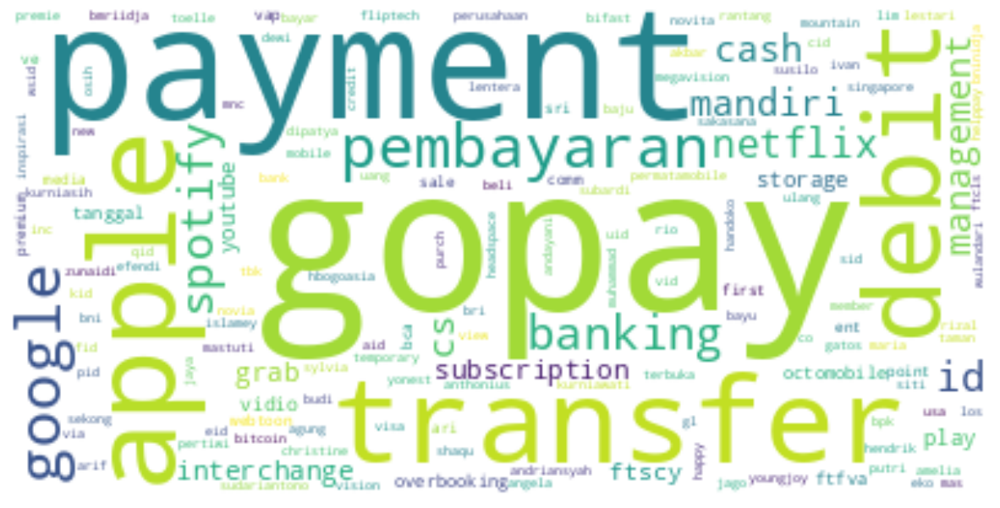

In [204]:
text = ' '.join([text for text in df_subs['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [205]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('gopay', 1206), ('payment', 1191), ('apple', 629), ('transfer', 624), ('debit', 488), ('pembayaran', 359), ('google', 352), ('banking', 321), ('spotify', 313), ('id', 240)]
[('gopay', 1.0), ('payment', 0.9875621890547264), ('apple', 0.521558872305141), ('transfer', 0.5174129353233831), ('debit', 0.4046434494195688), ('pembayaran', 0.29767827529021557), ('google', 0.29187396351575456), ('banking', 0.26616915422885573), ('spotify', 0.2595356550580431), ('id', 0.19900497512437812)]


In [206]:
df['description'][df['category']=='Subscription'][0:50]

79              bayar via banking wsid mnc vision webster
282                      debit interchange apple com bill
286                    debit interchange google hbogoasia
287                         debit interchange google play
288                  debit interchange google webtoon ent
289                 debit interchange google youtube prem
292                         debit interchange netflix com
294                             debit interchange spotify
295                          debit interchange spotify id
336      debit otomatis tanggal ftcls kurs xxxxxx netflix
920                       netflix seakun global teknologi
1526                       transfer banking debit spotify
1544             transfer banking debit ftfva first media
1567              transfer banking debit ftfva megavision
1594          transfer banking debit ftcls xxxxxx netflix
1595                       transfer banking debit netflix
1626    transfer banking debit netflix juni sampe nove...
1636          

In [207]:
df_subs[df_subs['description'].str.contains('youtube')]

,description,category
20,gopay payment youtube music awid,Subscription
22,gopay payment youtube premium llk id,Subscription
29,gopay payment youtube premium id,Subscription
57,gopay payment youtube vid,Subscription
58,gopay payment youtube premium eeioid,Subscription
...,...,...
2426,gopay payment youtube ylhzid,Subscription
2428,gopay payment youtube bgruid,Subscription
2429,gopay payment youtube premium xid,Subscription
2467,gopay payment youtube premium ych id,Subscription


In [208]:
df_subs = df_subs[df_subs['description'].str.contains('netflix|spotify|subscription|vidio|youtube')].reset_index(drop=True)

In [209]:
df_subs

,description,category
0,gopay payment spotify ade fee hrf vyid,Subscription
1,gopay payment vidio exwvid,Subscription
2,gopay payment youtube music awid,Subscription
3,gopay payment youtube premium llk id,Subscription
4,debit interchange spotify id,Subscription
...,...,...
923,gopay payment spotify itqh ojid,Subscription
924,debit interchange tanggal spotify id,Subscription
925,debit interchange spotify id,Subscription
926,debit interchange spotify id,Subscription


## Cash Withdrawal

In [210]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Tarik Tunai'].reset_index(drop=True).apply(lambda x: general(x))

In [211]:
df_tartun = pd.DataFrame({'description':data, 'category':['Cash Withdrawal']*len(data)})

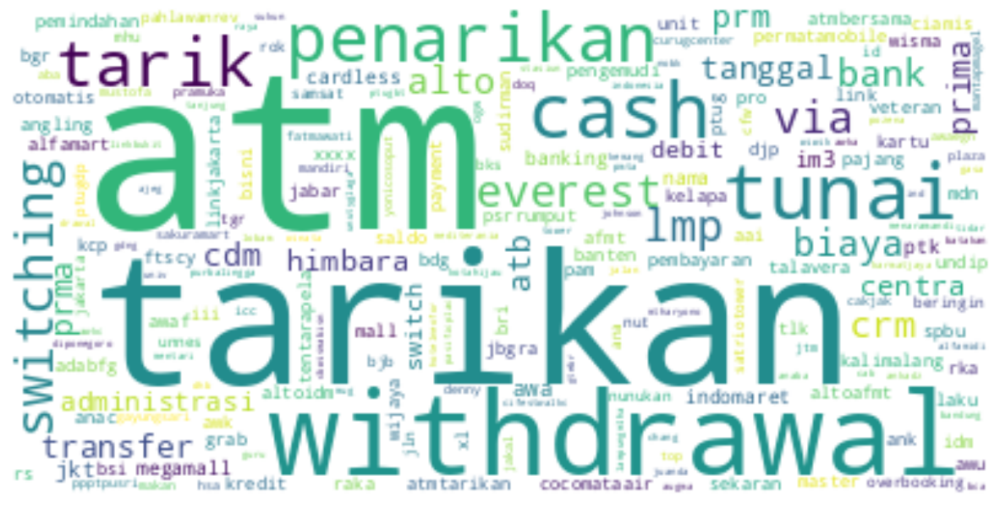

In [212]:
text = ' '.join([text for text in df_tartun['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [213]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('atm', 14568), ('tarikan', 9001), ('withdrawal', 4482), ('tunai', 1664), ('cash', 1512), ('penarikan', 1422), ('tarik', 1288), ('switching', 735), ('via', 527), ('everest', 517)]
[('atm', 1.0), ('tarikan', 0.6178610653487095), ('withdrawal', 0.30766062602965405), ('tunai', 0.11422295442064799), ('cash', 0.10378912685337727), ('penarikan', 0.09761120263591433), ('tarik', 0.08841295991213619), ('switching', 0.05045304777594728), ('via', 0.03617517847336628), ('everest', 0.03548874244920373)]


In [214]:
df['description'][df['category']=='Cash Withdrawal'][0:50]

25                          atm cash withdrawal jmata lmp
346             everest cash withdrawal via atm manokwari
865                                   cash withdrawal atb
910                                        penarikan dana
946                                         penarikan atm
947                              penarikan tunai atm bank
948                           penarikan tunai atm himbara
949                             penarikan tunai atm prima
970                         prma cash withdrawal prm unit
1157                              atm withdrawal pdkbambu
1158                          crm withdrawal atm bidakara
1159                                      cash withdrawal
1160                             cash withdrawal usd good
1161               cash drawal nobk penarikan modal usaha
1176                switching tanggal withdrawal alfamart
1177                                 switching withdrawal
1179                                          tarik tunai
1180          

In [215]:
df_tartun[df_tartun['description'].str.contains('tarik')]

,description,category
1,tarik tunai atm prima,Cash Withdrawal
2,tarik tunai atm prima,Cash Withdrawal
3,tarik tunai atm prima,Cash Withdrawal
4,tarik tunai atm,Cash Withdrawal
5,tarikan atm,Cash Withdrawal
...,...,...
16567,tarikan atm,Cash Withdrawal
16568,tarikan atm,Cash Withdrawal
16569,tarikan atm,Cash Withdrawal
16570,tarikan atm,Cash Withdrawal


In [216]:
df_tartun = df_tartun[df_tartun['description'].str.contains('withdrawal|tarik')].reset_index(drop=True)

In [217]:
df_tartun = df_tartun.sample(frac=1).reset_index(drop=True).iloc[0:1000]

In [218]:
df_tartun

,description,category
0,tarikan atm,Cash Withdrawal
1,tarikan atm,Cash Withdrawal
2,tarikan atm,Cash Withdrawal
3,tarikan atm,Cash Withdrawal
4,tarikan atm,Cash Withdrawal
...,...,...
995,atm cash withdrawal jbgra lmp,Cash Withdrawal
996,tarikan atm,Cash Withdrawal
997,tarikan atm,Cash Withdrawal
998,tarikan atm,Cash Withdrawal


## Home / Rent

In [219]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Rumah / Sewa'].reset_index(drop=True).apply(lambda x: general(x))

In [220]:
df_rumsew = pd.DataFrame({'description':data, 'category':['Home / Rent']*len(data)})

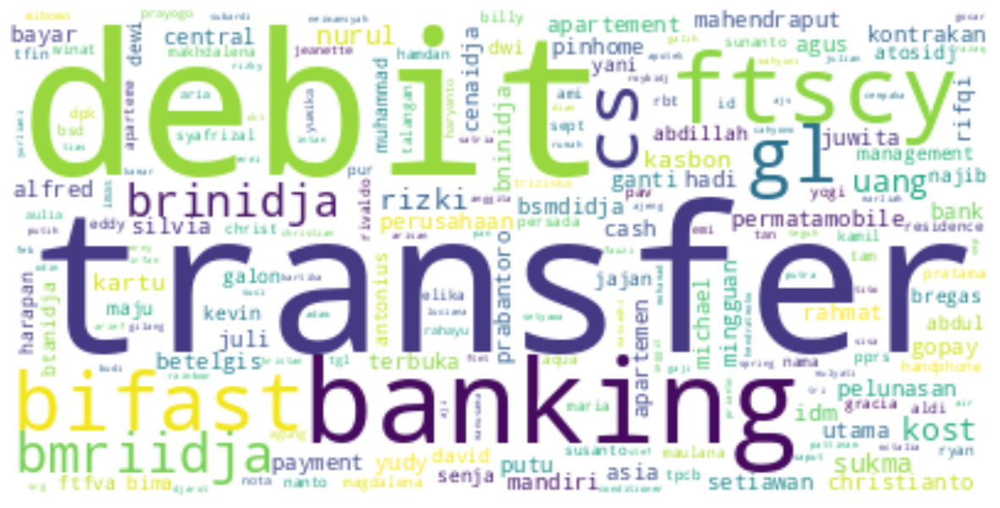

In [221]:
text = ' '.join([text for text in df_rumsew['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [222]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('transfer', 532), ('debit', 520), ('banking', 481), ('ftscy', 300), ('bifast', 291), ('cs', 277), ('gl', 266), ('bmriidja', 262), ('brinidja', 172), ('kost', 75)]
[('transfer', 1.0), ('debit', 0.9774436090225563), ('banking', 0.9041353383458647), ('ftscy', 0.5639097744360902), ('bifast', 0.5469924812030075), ('cs', 0.5206766917293233), ('gl', 0.5), ('bmriidja', 0.4924812030075188), ('brinidja', 0.3233082706766917), ('kost', 0.14097744360902256)]


In [223]:
df['description'][df['category']=='Home / Rent'][0:50]

39      bifast out cs gl bmriidja cenaidja bayar kost ...
40      bifast out cs gl bmriidja cenaidja bayar kost ...
41           bifast out cs gl bmriidja brinidja kontrakan
49      bifast out cs gl bmriidja cenaidja graha cakra...
168     debit domestik tanggal trn dom margonda residence
1895    bifast out cs gl bmriidja bninidja roos elaine...
1899    bifast out cs gl bmriidja cenaidja susanto bia...
1900    bifast out cs gl bmriidja cenaidja eddy sutant...
1901    bifast out cs gl bmriidja cenaidja eddy sutant...
1909          debit domestik tanggal trn dom bogor permai
1932                  debit domestik trn dom bogor permai
1953       debit otomatis ftcls kurs xxxxxx rev doc rumah
2231                       kartu debit idm tqqm apartemen
2297                       kartu debit pfm apartemen gadi
2386               kasbon rkd operasional pembuatan rumah
2390    pelunasan rumah lek madi rizki dewi larasati l...
2396               spare biaya pindahan rmh eni sulasteri
2560          

In [224]:
df_rumsew[df_rumsew['description'].str.contains('apartement')]

,description,category
133,kartu debit idm ftnt apartement pan,Home / Rent
134,kartu debit idm ftnt apartement pan,Home / Rent
170,kartu debit idm apartement tam,Home / Rent
171,kartu debit idm apartement tam,Home / Rent
172,kartu debit idm apartement tam,Home / Rent
173,kartu debit idm apartement tam,Home / Rent
174,kartu debit idm apartement tam,Home / Rent
175,kartu debit idm apartement tam,Home / Rent
176,kartu debit idm apartement tam,Home / Rent
177,kartu debit idm apartement tam,Home / Rent


In [225]:
df_rumsew = df_rumsew[df_rumsew['description'].str.contains('kost|apartemen')].reset_index(drop=True)

In [226]:
df_rumsew

,description,category
0,transfer banking debit kost fatmadewi sept emb...,Home / Rent
1,transfer banking debit kost fatmadewi agus tus...,Home / Rent
2,ajs kost cempaka putih,Home / Rent
3,ajs kost cempaka putih,Home / Rent
4,ajs kost cempaka putih,Home / Rent
...,...,...
109,kartu debit idm tfin apartement pur,Home / Rent
110,transfer banking debit uang kost nandira prama...,Home / Rent
111,transfer banking debit ftscy apartemen wasidin,Home / Rent
112,transfer banking debit ftscy apartemen wasidin,Home / Rent


## Books & Stationery

In [227]:
data = df['description'][df['category']=='Books & Stationery']

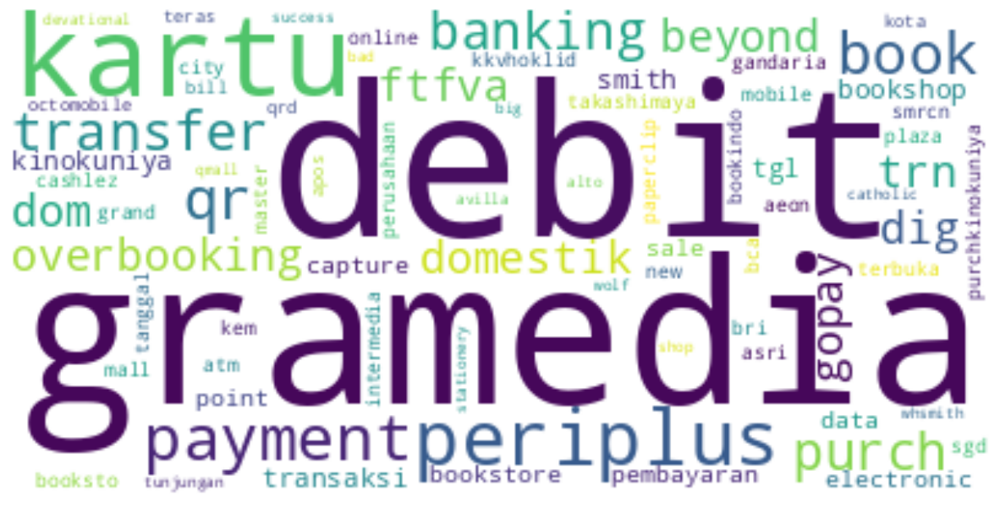

In [228]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [229]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 17), ('gramedia', 16), ('kartu', 9), ('periplus', 9), ('payment', 6), ('qr', 5), ('book', 5), ('transfer', 4), ('banking', 4), ('purch', 4)]
[('debit', 1.0), ('gramedia', 0.9411764705882353), ('kartu', 0.5294117647058824), ('periplus', 0.5294117647058824), ('payment', 0.35294117647058826), ('qr', 0.29411764705882354), ('book', 0.29411764705882354), ('transfer', 0.23529411764705882), ('banking', 0.23529411764705882), ('purch', 0.23529411764705882)]


In [230]:
data = data[data.str.contains('gramedia|periplus|book|buku|bookshop')].reset_index(drop=True)

In [231]:
data

0     overbooking atm master purchkinokuniya takashi...
1               debit domestik trn dom cashlez gramedia
2                          kartu debit books beyond kem
3                            kartu debit gramedia smrcn
4                              kartu debit books beyond
5                              kartu debit books beyond
6                                  kartu debit gramedia
7                        kartu debit intermedia booksto
8                         kartu debit periplus bookshop
9                       transaksi debit tgl qr gramedia
10                      transaksi debit tgl qr gramedia
11    transfer new bri mobile banking perusahaan ter...
12            transfer banking debit ftfva gramedia dig
13            transfer banking debit ftfva gramedia dig
14            transfer banking debit ftfva gramedia dig
15              gopay payment periplus online bookstore
16                           kartu debit periplus plaza
17            debit domestik trn dom periplus ae

In [232]:
df_book= aug_text(data, 'Books & Stationery')

In [233]:
df_book

,description,category
0,overbooking errak master purchkinokuniya takas...,Books & Stationery
1,overbooking tcash master purchkinokuniya takas...,Books & Stationery
2,overbooking prabayar master purchkinokuniya ta...,Books & Stationery
3,overbooking bca master purchkinokuniya takashi...,Books & Stationery
4,overbooking minimarket master purchkinokuniya ...,Books & Stationery
...,...,...
1345,big bad wolf paperback,Books & Stationery
1346,big bad wolf bloomsbury,Books & Stationery
1347,big bad wolf paperbacks,Books & Stationery
1348,big bad wolf macmillan,Books & Stationery


## Shipping

In [349]:
data = df['description'][df['category']=='Shipping']

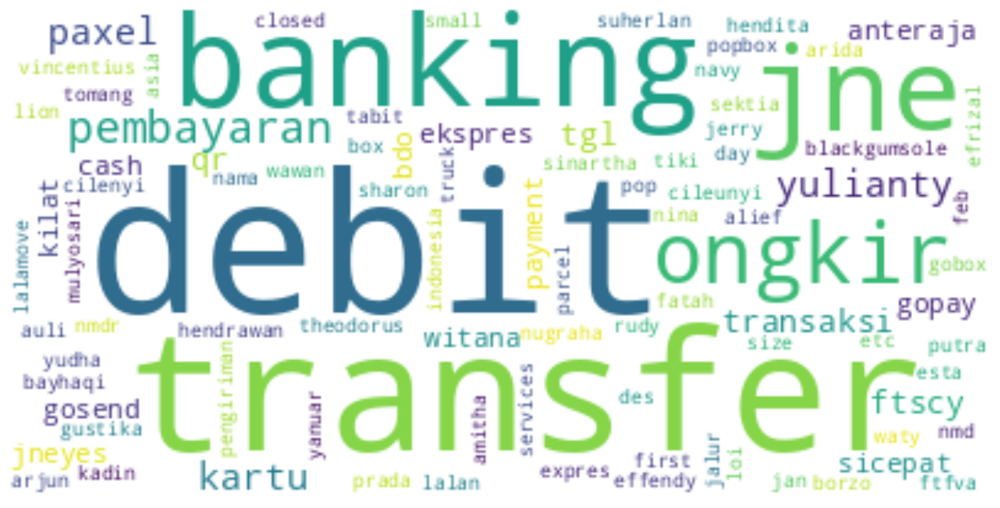

In [350]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [351]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 26), ('transfer', 19), ('banking', 19), ('jne', 17), ('ongkir', 7), ('pembayaran', 6), ('kartu', 4), ('yulianty', 4), ('paxel', 4), ('transaksi', 3)]
[('debit', 1.0), ('transfer', 0.7307692307692307), ('banking', 0.7307692307692307), ('jne', 0.6538461538461539), ('ongkir', 0.2692307692307692), ('pembayaran', 0.23076923076923078), ('kartu', 0.15384615384615385), ('yulianty', 0.15384615384615385), ('paxel', 0.15384615384615385), ('transaksi', 0.11538461538461539)]


In [352]:
data = data[data.str.contains('ongkir|paxel|anteraja|jne|gosend')].reset_index(drop=True)

In [353]:
data

0                          kartu debit kilat jne witana
1                                kartu debit jne tomang
2                          kartu debit kilat jne witana
3                     transaksi debit tgl qr jne expres
4                      transaksi debit tgl qr jne first
5          transfer banking debit nmdr blackgumsole jne
6        transfer banking debit ongkir jne jan yulianty
7     transfer banking debit jne nama theodorus lala...
8        transfer banking debit ongkir jne etc yulianty
9        transfer banking debit ongkir jne feb yulianty
10    transfer banking debit ongkir jne kadin vincen...
11    transfer banking debit nmd jneyes yudha sektia...
12     transfer banking debit ongkir jne rudy hendrawan
13    transfer banking debit ongkir jne alief bayhaq...
14    transfer banking debit jne jerry tabit efrizal...
15    transfer banking debit jne mulyosari nina waty...
16    transfer banking debit navy size jneyes wawan ...
17       transfer banking debit ongkir jne des y

In [354]:
df_ship = aug_text(data, 'Shipping')

In [355]:
paxel = df_ship[(df_ship['description'].str.contains('gopay')) & (df_ship['description'].str.contains('paxel'))]

In [356]:
df_ship = df_ship[~(df_ship['description'].str.contains('gopay'))]

In [357]:
df_ship = pd.concat([df_ship, paxel], ignore_index=True, sort=False).sample(frac=1).reset_index(drop=True)

In [358]:
df_ship

,description,category
0,kartu debit kilat jne jumeneng,Shipping
1,transfer securities debit ongkir jne rudy hend...,Shipping
2,transfer equity debit ongkir jne kadin vincent...,Shipping
3,transfer banking debit ongkir jne kadin aloysi...,Shipping
4,pengembalian banking debit ongkir jne etc yuli...,Shipping
...,...,...
1435,peminjaman banking debit ongkir jne des yulianty,Shipping
1436,gosend same afternoon,Shipping
1437,transfer banking debit ongkir jne gapensi vinc...,Shipping
1438,transfer banking debit ongkir jne lanlan bayha...,Shipping


## Laundry

In [241]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Kebutuhan Rumah Tangga'].reset_index(drop=True).apply(lambda x: general(x))

In [242]:
df_laundry = pd.DataFrame({'description':data, 'category':['Laundry']*len(data)})

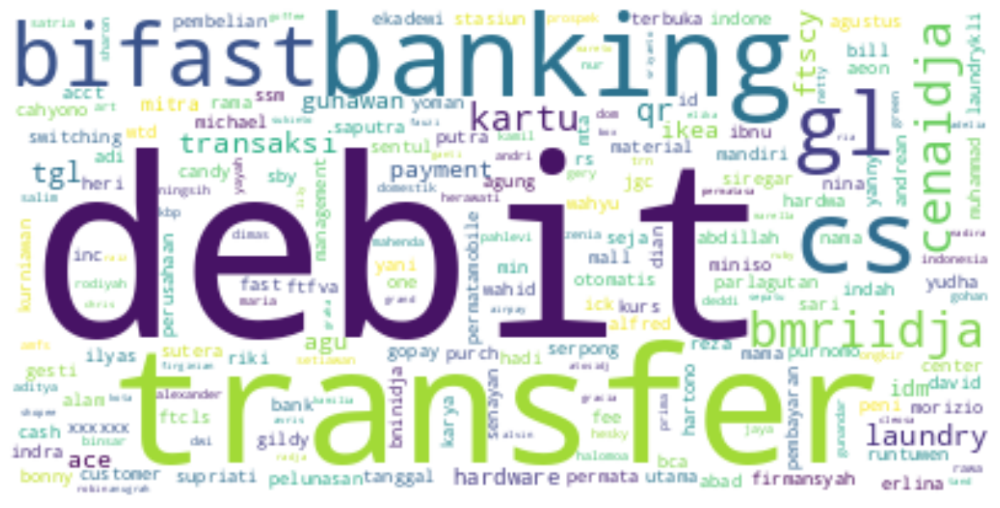

In [243]:
text = ' '.join([text for text in df_laundry['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [244]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 1303), ('transfer', 815), ('banking', 744), ('cs', 659), ('bifast', 650), ('gl', 648), ('bmriidja', 637), ('cenaidja', 613), ('kartu', 287), ('qr', 224)]
[('debit', 1.0), ('transfer', 0.6254796623177283), ('banking', 0.5709900230237912), ('cs', 0.5057559478127398), ('bifast', 0.49884881043745205), ('gl', 0.49731389102072143), ('bmriidja', 0.488871834228703), ('cenaidja', 0.47045280122793554), ('kartu', 0.2202609363008442), ('qr', 0.17191097467382963)]


In [245]:
df_laundry[df_laundry['description'].str.contains('laundry')]

,description,category
10,transaksi debit tgl qr laundrykli,Laundry
11,transaksi debit tgl qr laundrykli,Laundry
12,transaksi debit tgl qr laundrykli,Laundry
14,transaksi debit tgl qr laundrykli,Laundry
15,transaksi debit tgl qr laundrykli,Laundry
...,...,...
1913,transfer banking debit laundry gio hermanto gu...,Laundry
1973,transfer banking debit ftscy laundry kirei andi,Laundry
2094,transfer banking debit laundry cleosa marella,Laundry
2112,transfer banking debit ftscy pampers laundry n...,Laundry


In [246]:
df_laundry = df_laundry[df_laundry['description'].str.contains('laundry')].reset_index(drop=True)

In [247]:
df_laundry

,description,category
0,transaksi debit tgl qr laundrykli,Laundry
1,transaksi debit tgl qr laundrykli,Laundry
2,transaksi debit tgl qr laundrykli,Laundry
3,transaksi debit tgl qr laundrykli,Laundry
4,transaksi debit tgl qr laundrykli,Laundry
...,...,...
208,transfer banking debit laundry gio hermanto gu...,Laundry
209,transfer banking debit ftscy laundry kirei andi,Laundry
210,transfer banking debit laundry cleosa marella,Laundry
211,transfer banking debit ftscy pampers laundry n...,Laundry


## Sports

In [248]:
data = df['description'][df['category']=='Sports']

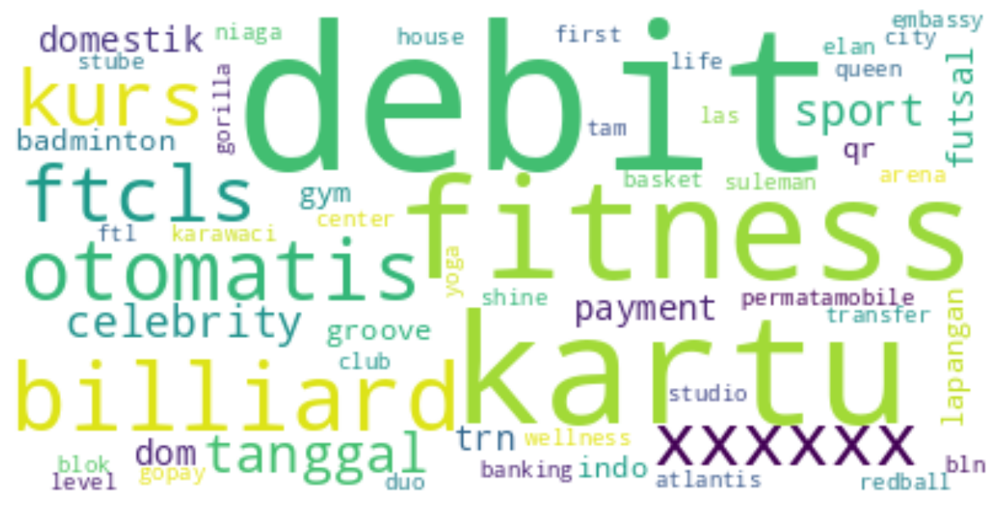

In [249]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [250]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 20), ('kartu', 10), ('fitness', 9), ('billiard', 7), ('otomatis', 6), ('ftcls', 6), ('kurs', 6), ('xxxxxx', 6), ('tanggal', 5), ('celebrity', 5)]
[('debit', 1.0), ('kartu', 0.5), ('fitness', 0.45), ('billiard', 0.35), ('otomatis', 0.3), ('ftcls', 0.3), ('kurs', 0.3), ('xxxxxx', 0.3), ('tanggal', 0.25), ('celebrity', 0.25)]


In [251]:
data = data[data.str.contains('gym|fitness|lapangan|futsal|basket')].reset_index(drop=True)

In [252]:
data

0               debit otomatis ftcls kurs xxxxxx futsal
1             debit otomatis ftcls kurs xxxxxx lapangan
2     debit otomatis tanggal ftcls kurs xxxxxx futsa...
3     debit otomatis tanggal ftcls kurs xxxxxx lapan...
4                         kartu debit celebrity fitness
5                           kartu debit karawaci futsal
6                      suleman permatamobile las basket
7                         kartu debit celebrity fitness
8                         kartu debit fitness first tam
9                                       fitness embassy
10                         qr payment celebrity fitness
11                gopay payment celebrity fitness niaga
12                                    duo shine fitness
13                                          gorilla gym
14                                              ftl gym
15                                         life fitness
16                                    celebrity fitness
Name: description, dtype: object

In [253]:
df_sport = aug_text(data, 'Sports')

In [254]:
df_sport

,description,category
0,saldo otomatis ftcls kurs xxxxxx futsal,Sports
1,likuiditas otomatis ftcls kurs xxxxxx futsal,Sports
2,bandwidth otomatis ftcls kurs xxxxxx futsal,Sports
3,genangan otomatis ftcls kurs xxxxxx futsal,Sports
4,m³ otomatis ftcls kurs xxxxxx futsal,Sports
...,...,...
655,celebrity skills,Sports
656,celebrity workout,Sports
657,celebrity billiard,Sports
658,celebrity squash,Sports


## Eye Care

In [255]:
data = df['description'][df['category']=='Eye Care']

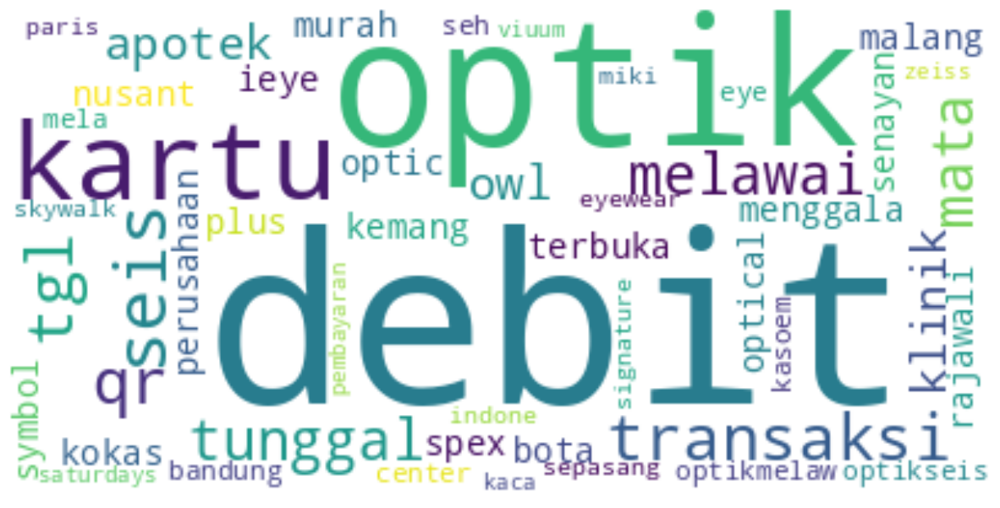

In [256]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [257]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 19), ('optik', 16), ('kartu', 15), ('seis', 5), ('transaksi', 4), ('tgl', 4), ('qr', 4), ('melawai', 3), ('mata', 3), ('tunggal', 3)]
[('debit', 1.0), ('optik', 0.8421052631578947), ('kartu', 0.7894736842105263), ('seis', 0.2631578947368421), ('transaksi', 0.21052631578947367), ('tgl', 0.21052631578947367), ('qr', 0.21052631578947367), ('melawai', 0.15789473684210525), ('mata', 0.15789473684210525), ('tunggal', 0.15789473684210525)]


In [258]:
data = data[data.str.contains('optik|apotek|melawai')].reset_index(drop=True)

In [259]:
data

0                       kartu debit optik seis kokas
1                      kartu debit optik seis kemang
2                     kartu debit optik melawai bota
3                             kartu debit ieye optik
4     kartu debit menggala apotek perusahaan terbuka
5                          kartu debit optik melawai
6                            kartu debit optik murah
7                     kartu debit optik seis senayan
8                      kartu debit spex symbol optik
9                  transaksi debit tgl qr optikmelaw
10                 transaksi debit tgl qr optik mela
11                 transaksi debit tgl qr apotek seh
12                  transaksi debit tgl qr optikseis
13                                    optik sepasang
14                                     optik melawai
15                                        optik seis
16                              optik seis signature
17                                     optik tunggal
18                             optik tunggal s

In [260]:
df_eye = aug_text(data, 'Eye Care')

In [261]:
df_eye

,description,category
0,card debit optik seis kokas,Eye Care
1,token debit optik seis kokas,Eye Care
2,paspor debit optik seis kokas,Eye Care
3,voucher debit optik seis kokas,Eye Care
4,kotak debit optik seis kokas,Eye Care
...,...,...
785,zeiss optik majemuk,Eye Care
786,zeiss optik terbuka,Eye Care
787,zeiss optik widiastawa,Eye Care
788,zeiss optik ketiga,Eye Care


## Public Transport

In [262]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Transportasi Umum'].reset_index(drop=True).apply(lambda x: general(x))

In [263]:
df_pubtrans = pd.DataFrame({'description':data, 'category':['Public Transport']*len(data)})

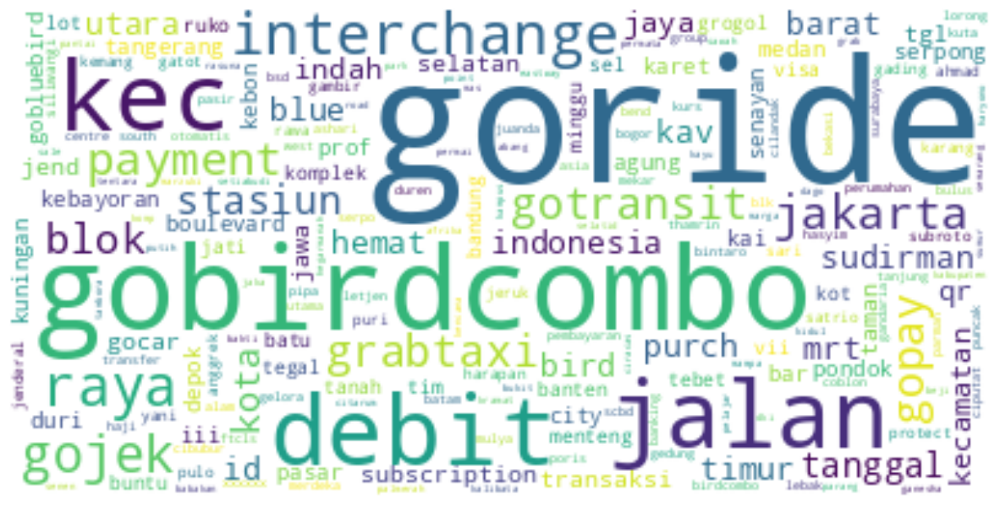

In [264]:
text = ' '.join([text for text in df_pubtrans['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [265]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('goride', 6209), ('gobirdcombo', 2253), ('debit', 1388), ('kec', 1367), ('jalan', 1264), ('interchange', 1131), ('raya', 1070), ('gojek', 874), ('payment', 699), ('jakarta', 677)]
[('goride', 1.0), ('gobirdcombo', 0.3628603639877597), ('debit', 0.223546464809148), ('kec', 0.22016427766145918), ('jalan', 0.20357545498469962), ('interchange', 0.18215493638267033), ('raya', 0.17233048800128845), ('gojek', 0.14076340795619263), ('payment', 0.11257851505878563), ('jakarta', 0.10903527138025447)]


In [266]:
df_pubtrans[df_pubtrans['description'].str.contains('grab')]

,description,category
240,debit interchange tanggal grab com,Public Transport
561,ve point sale comm vap grab,Public Transport
562,ve point sale comm vap grab,Public Transport
752,debit interchange www grabtaxi com,Public Transport
753,debit interchange www grabtaxi com,Public Transport
...,...,...
11722,debit interchange www grabtaxi com,Public Transport
11723,debit interchange www grabtaxi com,Public Transport
11724,debit interchange tanggal www grabtaxi com,Public Transport
11725,debit interchange tanggal www grabtaxi com,Public Transport


In [267]:
df_pubtrans = df_pubtrans[df_pubtrans['description'].str.contains('birdcombo|go|grab')].sample(frac=1).reset_index(drop=True)

In [268]:
df_pubtrans = df_pubtrans[0:1000]

In [269]:
df_pubtrans

,description,category
0,gotransit stasiun pasar minggu,Public Transport
1,goride raya mastrip kebraon kec,Public Transport
2,gobirdcombo harapan jaya cemp,Public Transport
3,goride klinik ibnu rusyd kota samarinda,Public Transport
4,gotransit stasiun taman kota,Public Transport
...,...,...
995,gocar sukaasih tangerang city ban,Public Transport
996,goride hemat hasyim ashari,Public Transport
997,goride jalan pejanggik mataram barat kota mat,Public Transport
998,debit interchange www grabtaxi com,Public Transport


## Electricity & Water Bills

In [270]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Tagihan Listrik dan Air'].reset_index(drop=True).apply(lambda x: general(x))

In [271]:
df_lisaer = pd.DataFrame({'description':data, 'category':['Electricity & Water Bills']*len(data)})

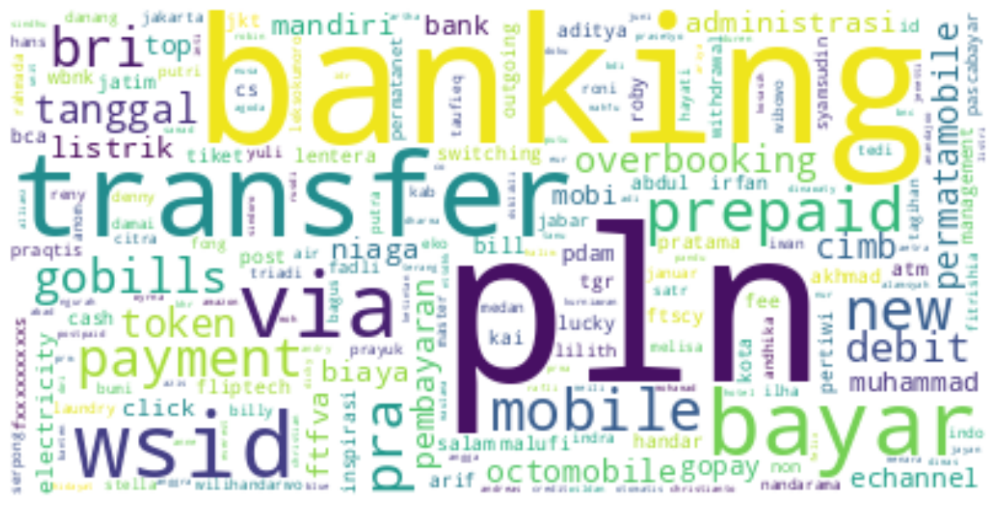

In [272]:
text = ' '.join([text for text in df_lisaer['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [273]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('pln', 1211), ('banking', 781), ('transfer', 686), ('via', 376), ('bayar', 374), ('wsid', 371), ('prepaid', 354), ('mobile', 333), ('new', 325), ('pra', 279)]
[('pln', 1.0), ('banking', 0.6449215524360034), ('transfer', 0.5664739884393064), ('via', 0.3104872006606111), ('bayar', 0.3088356729975227), ('wsid', 0.3063583815028902), ('prepaid', 0.29232039636663915), ('mobile', 0.2749793559042114), ('new', 0.26837324525185796), ('pra', 0.23038810900082576)]


In [274]:
df_lisaer[df_lisaer['description'].str.contains('pdam')]

,description,category
18,gobills pdam kota banjarbaru,Electricity & Water Bills
89,gobills pdam kab sleman,Electricity & Water Bills
141,transfer banking debit ftfva pdam kota,Electricity & Water Bills
152,gobills pdam kab deli serdang,Electricity & Water Bills
175,transfer banking debit ftfva pdam kota,Electricity & Water Bills
177,transfer banking debit ftfva pdam kota,Electricity & Water Bills
184,gobills pdam kab bekasi,Electricity & Water Bills
196,transfer banking debit ftfva pdam kota,Electricity & Water Bills
283,gobills pdam kab bekasi,Electricity & Water Bills
346,transfer banking debit ftfva pdam kota,Electricity & Water Bills


In [275]:
df_lisaer = df_lisaer[df_lisaer['description'].str.contains('pln|tagihan|pdam')].sample(frac=1).reset_index(drop=True)

In [276]:
df_lisaer

,description,category
0,transfer pln pra new bri mobile banking,Electricity & Water Bills
1,transfer pln pra new bri mobile banking,Electricity & Water Bills
2,transfer pln post new bri mobile banking,Electricity & Water Bills
3,gobills pln token,Electricity & Water Bills
4,bayar via banking wsid pln prepaid monique pri...,Electricity & Water Bills
...,...,...
1244,gobills pln token,Electricity & Water Bills
1245,gobills pln token,Electricity & Water Bills
1246,pln pembayaran,Electricity & Water Bills
1247,bill payment octomobile pln praqtis,Electricity & Water Bills


## Pets

In [277]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Hewan Peliharaan'].reset_index(drop=True).apply(lambda x: general(x))

In [278]:
df_pet = pd.DataFrame({'description':data, 'category':['Pets']*len(data)})

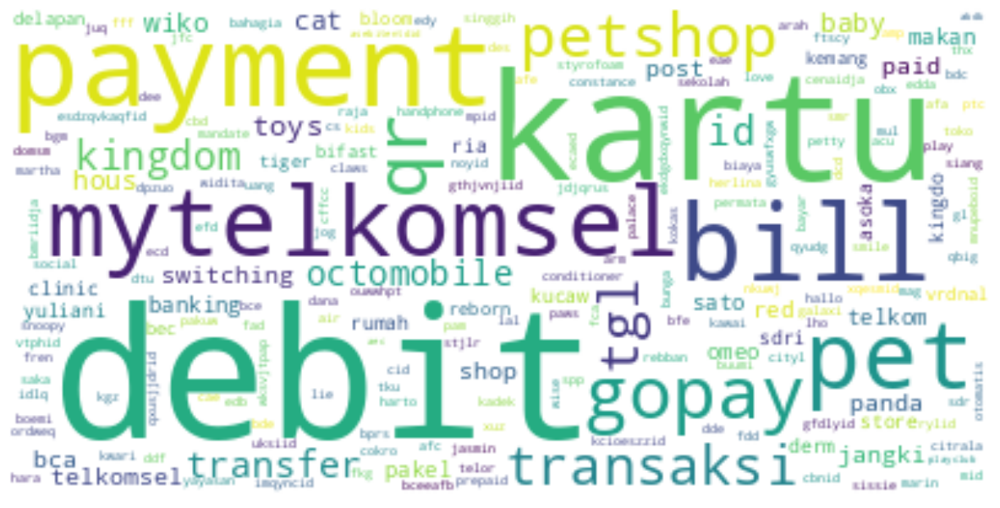

In [279]:
text = ' '.join([text for text in df_pet['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [280]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 88), ('kartu', 58), ('payment', 53), ('bill', 45), ('mytelkomsel', 36), ('pet', 34), ('gopay', 31), ('qr', 30), ('petshop', 29), ('transaksi', 22)]
[('debit', 1.0), ('kartu', 0.6590909090909091), ('payment', 0.6022727272727273), ('bill', 0.5113636363636364), ('mytelkomsel', 0.4090909090909091), ('pet', 0.38636363636363635), ('gopay', 0.3522727272727273), ('qr', 0.3409090909090909), ('petshop', 0.32954545454545453), ('transaksi', 0.25)]


In [281]:
df_pet[df_pet['description'].str.contains('cat')]

,description,category
47,qr payment wiko petshop cat hous,Pets
48,qr payment wiko petshop cat hous,Pets
49,qr payment wiko petshop cat hous,Pets
50,qr payment wiko petshop cat hous,Pets
51,qr payment wiko petshop cat hous,Pets
52,qr payment wiko petshop cat hous,Pets


In [282]:
df_pet = df_pet[df_pet['description'].str.contains('pet|petshop')].sample(frac=1).reset_index(drop=True)

In [283]:
df_pet

,description,category
0,transaksi debit tgl qr sato pet,Pets
1,transaksi debit tgl qr jangki pet,Pets
2,kartu debit mon pet,Pets
3,transaksi debit tgl qr pet kingdo,Pets
4,qr payment wiko petshop cat hous,Pets
...,...,...
58,transfer bifast margiastoeti bank central asia...,Pets
59,kartu debit pet derm clinic,Pets
60,transaksi debit tgl qr tiger pets,Pets
61,kartu debit delapan pet shop,Pets


## Education

In [284]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Pendidikan Pribadi'].reset_index(drop=True).apply(lambda x: general(x))

In [285]:
df_edu = pd.DataFrame({'description':data, 'category':['Education']*len(data)})

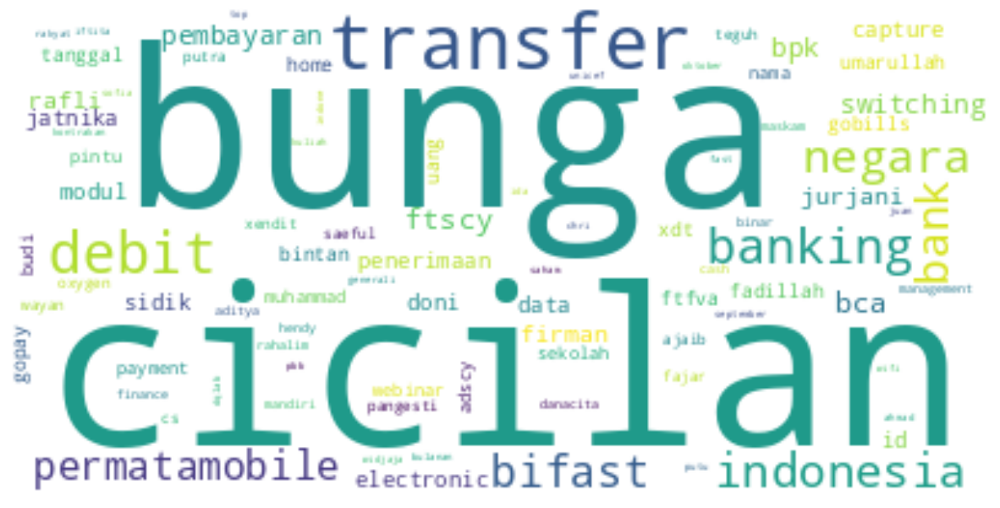

In [286]:
text = ' '.join([text for text in df_edu['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [287]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('bunga', 276), ('cicilan', 274), ('transfer', 200), ('debit', 97), ('banking', 71), ('indonesia', 61), ('negara', 60), ('bank', 54), ('bifast', 52), ('permatamobile', 51)]
[('bunga', 1.0), ('cicilan', 0.9927536231884058), ('transfer', 0.7246376811594203), ('debit', 0.35144927536231885), ('banking', 0.2572463768115942), ('indonesia', 0.2210144927536232), ('negara', 0.21739130434782608), ('bank', 0.1956521739130435), ('bifast', 0.18840579710144928), ('permatamobile', 0.18478260869565216)]


In [288]:
df_edu[df_edu['description'].str.contains('cicilan')]

,description,category
1,bunga cicilan,Education
2,bunga cicilan,Education
3,bunga cicilan,Education
4,bunga cicilan,Education
5,bunga cicilan,Education
...,...,...
505,bunga cicilan,Education
506,bunga cicilan,Education
507,bunga cicilan,Education
508,bunga cicilan,Education


In [289]:
df_edu = df_edu[df_edu['description'].str.contains('sekolah')].sample(frac=1).reset_index(drop=True)

In [290]:
df_edu

,description,category
0,transfer banking debit ftfva sekolahmu,Education
1,transfer banking debit ftscy sekolah dida feri...,Education
2,bifast out cs gl bmriidja bsmdidja boy konga k...,Education
3,sekolah bambini,Education
4,transfer banking debit sekolah tjen zein viccar,Education
5,transfer banking debit ftscy sekolah ekoagusp ...,Education
6,transfer banking debit sekolah bola ignatius a...,Education


## Credit Card

In [291]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Kartu Kredit'].reset_index(drop=True).apply(lambda x: general(x))

In [292]:
df_karkred = pd.DataFrame({'description':data, 'category':['Credit Card']*len(data)})

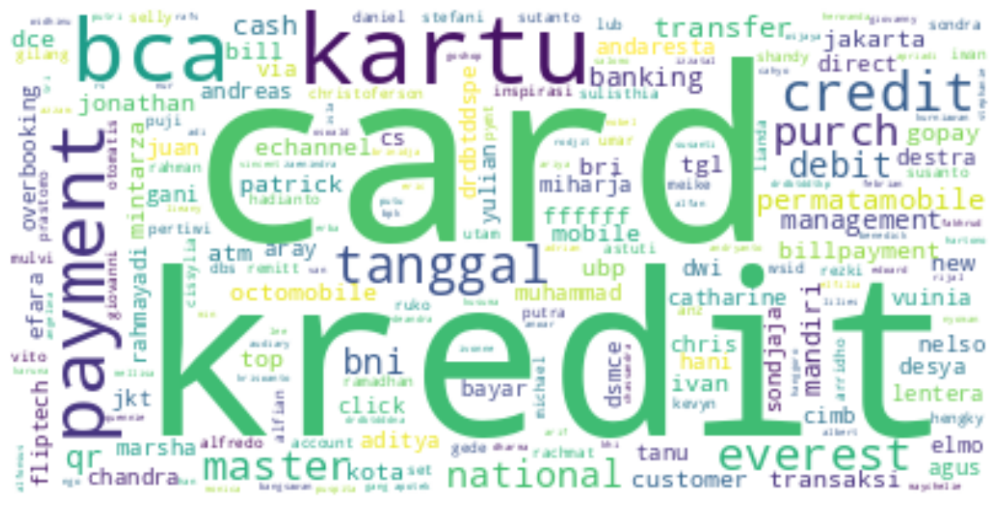

In [293]:
text = ' '.join([text for text in df_karkred['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [294]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('card', 1983), ('kredit', 1684), ('kartu', 1682), ('bca', 1327), ('payment', 972), ('credit', 431), ('tanggal', 375), ('everest', 303), ('purch', 244), ('master', 234)]
[('card', 1.0), ('kredit', 0.8492183560262229), ('kartu', 0.848209783156833), ('bca', 0.6691880988401412), ('payment', 0.49016641452344933), ('credit', 0.21734745335350478), ('tanggal', 0.18910741301059), ('everest', 0.15279878971255673), ('purch', 0.12304589006555723), ('master', 0.11800302571860817)]


In [295]:
df_karkred[df_karkred['description'].str.contains('card')]

,description,category
0,kartu kredit bca card anadia putri anind,Credit Card
1,kartu kredit bca card anadia putri anind,Credit Card
2,kartu kredit bca card anadia putri anind,Credit Card
3,kartu kredit bca card anadia putri anind,Credit Card
4,kartu kredit bca card anadia putri anind,Credit Card
...,...,...
2661,kartu kredit tanggal bca card anita,Credit Card
2663,kartu kredit bca card suhainda librado,Credit Card
2664,kartu kredit tanggal bca card suhainda librado,Credit Card
2665,kartu kredit bca card suhainda librado,Credit Card


In [296]:
df_karkred = df_karkred[df_karkred['description'].str.contains('card')].sample(frac=1).reset_index(drop=True)

In [297]:
df_karkred

,description,category
0,kartu kredit bca card okky vinasty anand,Credit Card
1,everest credit card payment,Credit Card
2,kartu kredit bca card patrick mintarza,Credit Card
3,kartu kredit bca card vito shandy sondra,Credit Card
4,kartu kredit tanggal bca card fakhrud zaenindra,Credit Card
...,...,...
1978,kartu kredit bca card desya andaresta,Credit Card
1979,kartu kredit bca card adrian kurnia,Credit Card
1980,kartu kredit bca card iwan,Credit Card
1981,everest credit card payment,Credit Card


## Taxes

In [298]:
data = df['description'][df['category']=='Taxes']

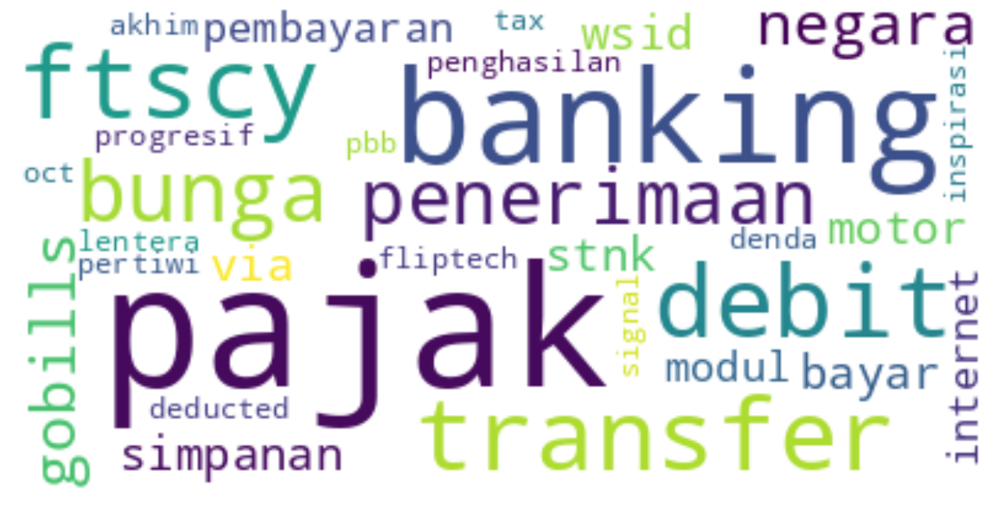

In [299]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [300]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('pajak', 9), ('banking', 5), ('transfer', 3), ('debit', 3), ('ftscy', 3), ('bunga', 2), ('penerimaan', 2), ('negara', 2), ('gobills', 2), ('simpanan', 1)]
[('pajak', 1.0), ('banking', 0.5555555555555556), ('transfer', 0.3333333333333333), ('debit', 0.3333333333333333), ('ftscy', 0.3333333333333333), ('bunga', 0.2222222222222222), ('penerimaan', 0.2222222222222222), ('negara', 0.2222222222222222), ('gobills', 0.2222222222222222), ('simpanan', 0.1111111111111111)]


In [301]:
data = data[data.str.contains('pajak|stnk')].reset_index(drop=True)

In [302]:
data

0                                 pajak bunga simpanan
1                                                pajak
2                                           stnk motor
3                                    pajak penghasilan
4                                                pajak
5    pajak progresif fliptech lentera inspirasi per...
6                                          pajak bunga
7                   transfer banking debit ftscy pajak
8             transfer banking debit ftscy denda pajak
9         transfer banking debit ftscy pajak akhim oct
Name: description, dtype: object

In [303]:
df_tax = aug_text(data, 'Taxes')

In [304]:
df_tax

,description,category
0,pajaknya bunga simpanan,Taxes
1,retribusi bunga simpanan,Taxes
2,pengenaan bunga simpanan,Taxes
3,cukai bunga simpanan,Taxes
4,perpajakan bunga simpanan,Taxes
...,...,...
305,transfer banking debit ftscy pajak akhim ifop,Taxes
306,transfer banking debit ftscy pajak akhim july,Taxes
307,transfer banking debit ftscy pajak akhim nov,Taxes
308,transfer banking debit ftscy pajak akhim opini...,Taxes


## Dentist

In [305]:
data = df['description'][df['category']=='Dentist']

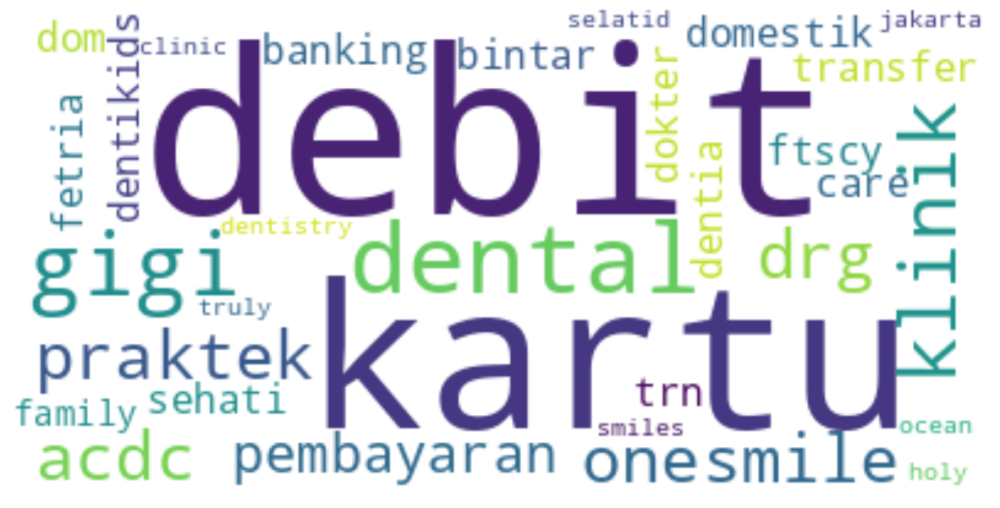

In [306]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [307]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 8), ('kartu', 6), ('dental', 5), ('gigi', 4), ('klinik', 3), ('acdc', 2), ('praktek', 2), ('drg', 2), ('onesmile', 2), ('pembayaran', 2)]
[('debit', 1.0), ('kartu', 0.75), ('dental', 0.625), ('gigi', 0.5), ('klinik', 0.375), ('acdc', 0.25), ('praktek', 0.25), ('drg', 0.25), ('onesmile', 0.25), ('pembayaran', 0.25)]


In [308]:
data = data[data.str.contains('dental|dentikids|onesmile')].reset_index(drop=True)

In [309]:
data

0    debit domestik trn dom dentikids
1                  dentia dental care
2                 onesmile pembayaran
3           holy smiles dental clinic
4                              dental
5            kartu debit truly dental
6                 onesmile pembayaran
7                        ocean dental
Name: description, dtype: object

In [310]:
df_dentist = aug_text(data, 'Dentist')

In [311]:
df_dentist

,description,category
0,saldo domestik trn dom dentikids,Dentist
1,likuiditas domestik trn dom dentikids,Dentist
2,bandwidth domestik trn dom dentikids,Dentist
3,genangan domestik trn dom dentikids,Dentist
4,m³ domestik trn dom dentikids,Dentist
...,...,...
185,ocean apical,Dentist
186,ocean alveolo,Dentist
187,ocean caries,Dentist
188,ocean velar,Dentist


## Services Needs

In [312]:
data = df['description'][df['category']=='Services Needs']

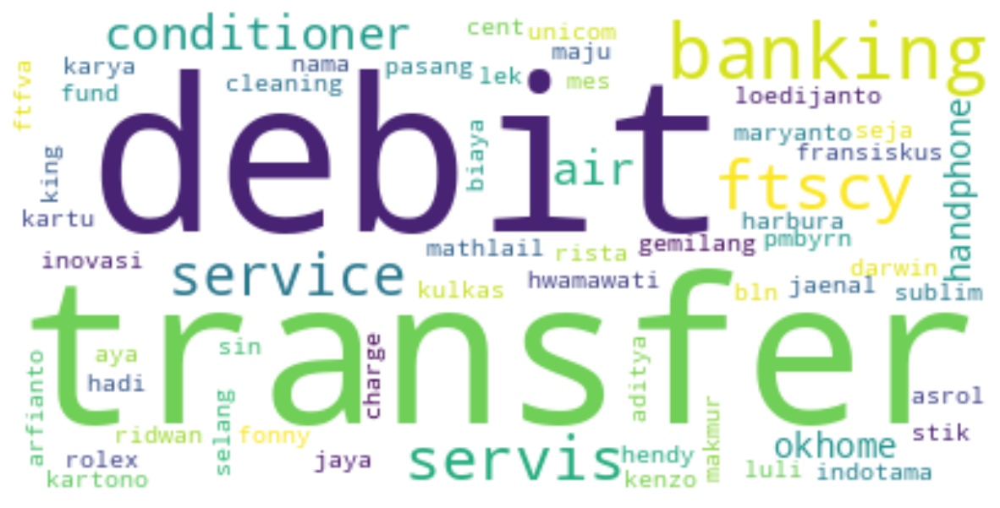

In [313]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [314]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('debit', 12), ('transfer', 11), ('banking', 11), ('ftscy', 8), ('servis', 7), ('service', 6), ('air', 4), ('conditioner', 4), ('okhome', 2), ('handphone', 2)]
[('debit', 1.0), ('transfer', 0.9166666666666666), ('banking', 0.9166666666666666), ('ftscy', 0.6666666666666666), ('servis', 0.5833333333333334), ('service', 0.5), ('air', 0.3333333333333333), ('conditioner', 0.3333333333333333), ('okhome', 0.16666666666666666), ('handphone', 0.16666666666666666)]


In [315]:
data = data[data.str.contains('okhome|cleaning|indotama|unicom')].reset_index(drop=True)

In [316]:
data

0    okhome pasang selang air conditioner inovasi i...
1                  transfer banking debit ftfva okhome
2    servis handphone aditya unicom harbura jaya ma...
3    transfer banking debit service cleaning jaenal...
Name: description, dtype: object

In [317]:
df_serviceneed = aug_text(data, 'Services Needs')

In [318]:
df_serviceneed

,description,category
0,okhome surut selang air conditioner inovasi in...,Services Needs
1,okhome ombak selang air conditioner inovasi in...,Services Needs
2,okhome surutnya selang air conditioner inovasi...,Services Needs
3,okhome ekor selang air conditioner inovasi ind...,Services Needs
4,okhome lajur selang air conditioner inovasi in...,Services Needs
...,...,...
215,transfer banking debit service cleaning sofian...,Services Needs
216,transfer banking debit service cleaning mokham...,Services Needs
217,transfer banking debit service cleaning riduan...,Services Needs
218,transfer banking debit service cleaning toriq ...,Services Needs


## Printshop

In [319]:
data = df['description'][df['category']=='Printshop']

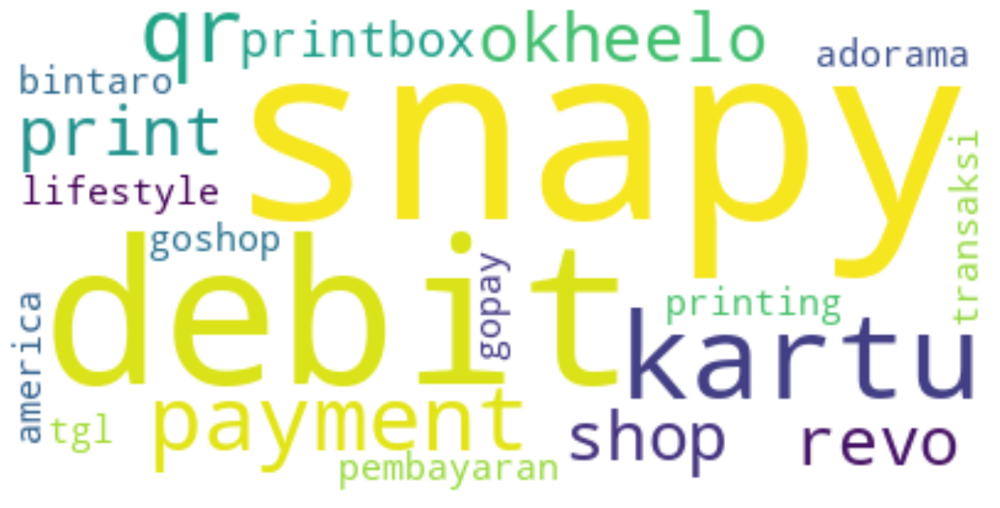

In [320]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [321]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('snapy', 5), ('debit', 3), ('kartu', 2), ('payment', 2), ('qr', 2), ('okheelo', 1), ('revo', 1), ('print', 1), ('shop', 1), ('printbox', 1)]
[('snapy', 1.0), ('debit', 0.6), ('kartu', 0.4), ('payment', 0.4), ('qr', 0.4), ('okheelo', 0.2), ('revo', 0.2), ('print', 0.2), ('shop', 0.2), ('printbox', 0.2)]


In [322]:
data = data[data.str.contains('snapy|adorama|printing|okheelo')].reset_index(drop=True)

In [323]:
data

0             kartu debit okheelo
1      adorama lifestyle printing
2     gopay payment snapy bintaro
3                qr payment snapy
4               kartu debit snapy
5    transaksi debit tgl qr snapy
6            goshop snapy america
Name: description, dtype: object

In [324]:
df_print = aug_text(data, 'Printshop')

In [325]:
df_print

,description,category
0,card debit okheelo,Printshop
1,token debit okheelo,Printshop
2,paspor debit okheelo,Printshop
3,voucher debit okheelo,Printshop
4,kotak debit okheelo,Printshop
...,...,...
155,goshop snapy nanook,Printshop
156,goshop snapy carolina,Printshop
157,goshop snapy presidents,Printshop
158,goshop snapy agents,Printshop


## Car Loan

In [326]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Cicilan Mobil'].reset_index(drop=True).apply(lambda x: general(x))

In [327]:
df_cicilmob= pd.DataFrame({'description':data, 'category':['Car Loan']*len(data)})

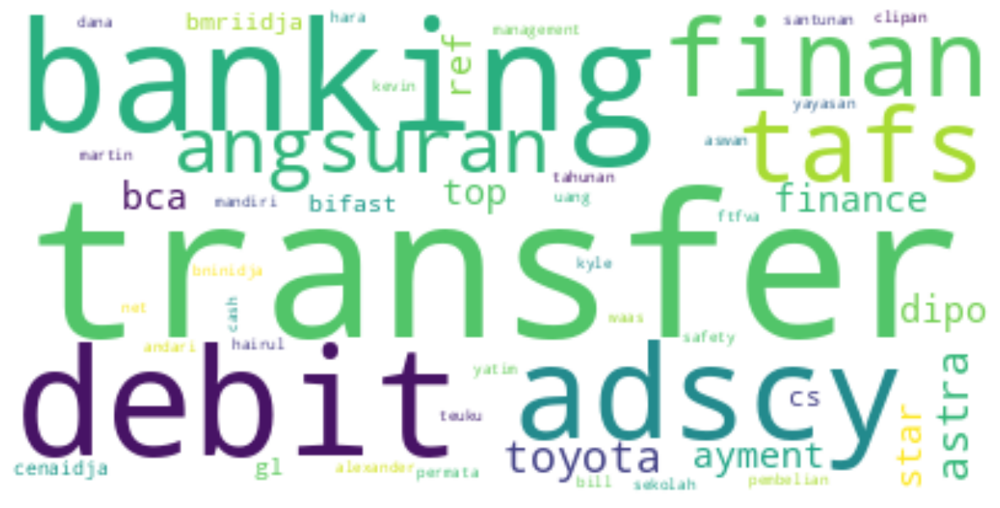

In [328]:
text = ' '.join([text for text in df_cicilmob['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [329]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('transfer', 22), ('banking', 21), ('debit', 21), ('adscy', 20), ('finan', 13), ('tafs', 12), ('angsuran', 12), ('toyota', 12), ('astra', 12), ('ref', 8)]
[('transfer', 1.0), ('banking', 0.9545454545454546), ('debit', 0.9545454545454546), ('adscy', 0.9090909090909091), ('finan', 0.5909090909090909), ('tafs', 0.5454545454545454), ('angsuran', 0.5454545454545454), ('toyota', 0.5454545454545454), ('astra', 0.5454545454545454), ('ref', 0.36363636363636365)]


In [330]:
df['description'][df['category']=='Car Loan']

1560    transfer banking debit adscy ref bca top aymen...
1726    transfer banking debit adscy ref bca top aymen...
2380       jaminan overkredit mobil pickup agus nurmansah
2961            transfer banking debit ftfva suzuki finan
2962          transfer banking debit ftfva suzuki finance
2964             transfer banking debit ftfva wom finance
2965    transfer banking debit adscy tafs angsuran toy...
Name: description, dtype: object

In [331]:
df_cicilmob[df_cicilmob['description'].str.contains('tahunan')]

,description,category
18,bifast out cs gl bmriidja cenaidja yayasan sek...,Car Loan


In [332]:
df_cicilmob = df_cicilmob[df_cicilmob['description'].str.contains('angsuran|toyota')].sample(frac=1).reset_index(drop=True)

In [333]:
df_cicilmob

,description,category
0,transfer banking debit adscy tafs angsuran toy...,Car Loan
1,transfer banking debit adscy tafs angsuran toy...,Car Loan
2,transfer banking debit adscy tafs angsuran toy...,Car Loan
3,transfer banking debit adscy tafs angsuran toy...,Car Loan
4,transfer banking debit adscy tafs angsuran toy...,Car Loan
5,transfer banking debit adscy tafs angsuran toy...,Car Loan
6,transfer banking debit adscy tafs angsuran toy...,Car Loan
7,transfer banking debit adscy tafs angsuran toy...,Car Loan
8,transfer banking debit adscy tafs angsuran toy...,Car Loan
9,transfer banking debit adscy tafs angsuran toy...,Car Loan


## Business Expense

In [334]:
data = df['description'][df['category']=='Business Expense']

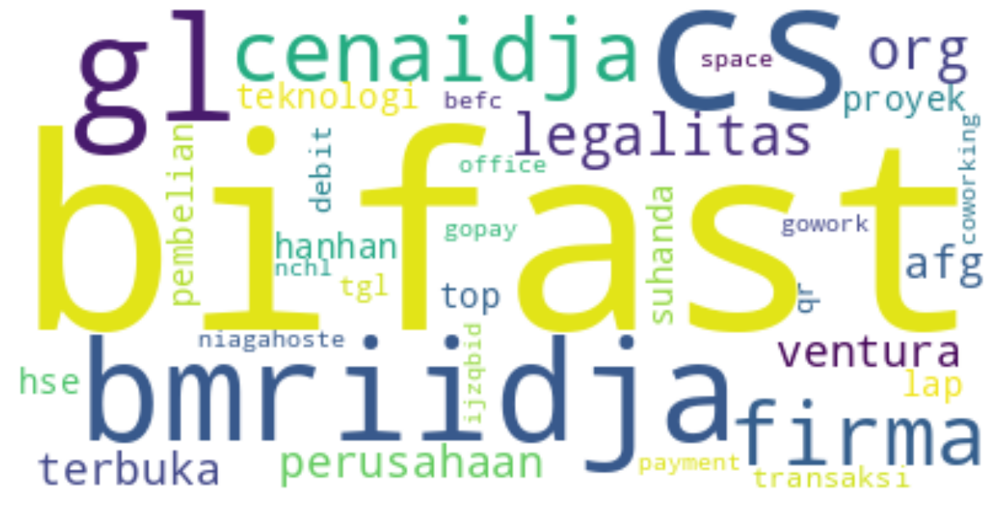

In [335]:
text = ' '.join([text for text in data])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15,10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [336]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('bifast', 1), ('cs', 1), ('gl', 1), ('bmriidja', 1), ('cenaidja', 1), ('firma', 1), ('legalitas', 1), ('org', 1), ('perusahaan', 1), ('terbuka', 1)]
[('bifast', 1.0), ('cs', 1.0), ('gl', 1.0), ('bmriidja', 1.0), ('cenaidja', 1.0), ('firma', 1.0), ('legalitas', 1.0), ('org', 1.0), ('perusahaan', 1.0), ('terbuka', 1.0)]


In [337]:
data = data[data.str.contains('ventura')].reset_index(drop=True)

In [338]:
data

0    bifast out cs gl bmriidja cenaidja firma legal...
Name: description, dtype: object

In [339]:
df_buss = aug_text(data, 'Business Expense')

In [340]:
df_buss

,description,category
0,bifast down cs gl bmriidja cenaidja firma lega...,Business Expense
1,bifast knock cs gl bmriidja cenaidja firma leg...,Business Expense
2,bifast away cs gl bmriidja cenaidja firma lega...,Business Expense
3,bifast takes cs gl bmriidja cenaidja firma leg...,Business Expense
4,bifast moves cs gl bmriidja cenaidja firma leg...,Business Expense
...,...,...
105,bifast out cs gl bmriidja cenaidja firma legal...,Business Expense
106,bifast out cs gl bmriidja cenaidja firma legal...,Business Expense
107,bifast out cs gl bmriidja cenaidja firma legal...,Business Expense
108,bifast out cs gl bmriidja cenaidja firma legal...,Business Expense


## Family

In [341]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Uang untuk Orang Tua atau Istri'].reset_index(drop=True).apply(lambda x: general(x))

In [342]:
df_fam= pd.DataFrame({'description':data, 'category':['Family']*len(data)})

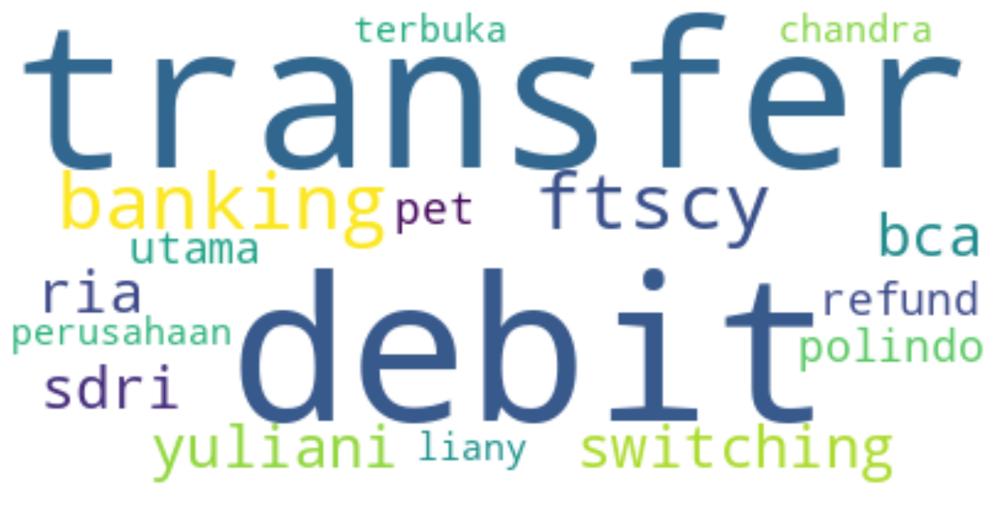

In [343]:
text = ' '.join([text for text in df_fam['description']])

# Create stopword list:
stopwords = set(STOPWORDS)

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white", collocations = False).generate(text)

# Display the generated image:
# the matplotlib way:
plt.figure(figsize=(15, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [344]:
text_dictionary = wordcloud.process_text(text)
# sort the dictionary
word_freq={k: v for k, v in sorted(text_dictionary.items(),reverse=True, key=lambda item: item[1])}

#use words_ to print relative word frequencies
rel_freq=wordcloud.words_

#print results
print(list(word_freq.items())[:10])
print(list(rel_freq.items())[:10])

[('transfer', 4), ('debit', 4), ('banking', 2), ('ftscy', 2), ('switching', 2), ('sdri', 2), ('ria', 2), ('yuliani', 2), ('bca', 2), ('refund', 1)]
[('transfer', 1.0), ('debit', 1.0), ('banking', 0.5), ('ftscy', 0.5), ('switching', 0.5), ('sdri', 0.5), ('ria', 0.5), ('yuliani', 0.5), ('bca', 0.5), ('refund', 0.25)]


In [345]:
df_fam

,description,category
0,transfer banking debit ftscy refund pet polind...,Family
1,switching debit transfer sdri ria yuliani bca,Family
2,switching debit transfer sdri ria yuliani bca,Family
3,transfer banking debit ftscy liany chandra,Family


## Home Loan

In [346]:
data = df_baru['Description'].loc[df_baru['Ml Categorization']=='Cicilan Rumah'].reset_index(drop=True).apply(lambda x: general(x))

In [347]:
df_cicilrum= pd.DataFrame({'description':data, 'category':['Home Loan']*len(data)})

In [348]:
df_cicilrum

,description,category
0,pembayaran pinj kppr,Home Loan
1,pembayaran pinj kppr,Home Loan
2,pembayaran pinj kppr,Home Loan
3,sakinah minimarket bunga pembayaran,Home Loan
4,sakinah minimarket bunga pembayaran,Home Loan
...,...,...
412,pembayaran pinj kppr,Home Loan
413,pembayaran pinj kppr,Home Loan
414,pembayaran pinj kpa kpr,Home Loan
415,pembayaran pinj kpa kpr,Home Loan


# Create New DS

In [359]:
data = [df_fashion, df_BeaCare, df_hm, df_groceries, df_inv, df_pin, df_tepin, df_hadiah, df_gas, df_gadget, df_serpis, df_hiburan, df_travel, df_donasi, df_fee, df_kids, df_belanja, df_top, df_household, df_trans, df_asu, df_subs, df_tartun, df_rumsew, df_book, df_ship, df_laundry, df_sport, df_eye, df_pubtrans, df_lisaer, df_pet, df_edu,  df_karkred, df_tax, df_dentist, df_serviceneed, df_print, df_cicilmob, df_buss, df_fam, df_cicilrum]

In [360]:
df_new = pd.concat(data, ignore_index=True, sort=False)

In [361]:
df_new.shape

(35267, 2)

In [362]:
df_new.drop_duplicates(subset=['description'], inplace=True)

In [363]:
df_new.shape

(24636, 2)

In [366]:
df_new = pd.concat([df.drop('bank_name', axis=1), df_new], ignore_index=True, sort=False).sample(frac=1).reset_index(drop=True)

In [367]:
df_new

,description,category
0,wallet payment paxel,Shipping
1,penarikan tunai atm himbara,Cash Withdrawal
2,debit domestik tanggal trn joão lisa hotel,Travel
3,transfer banking tagihan ftscy uang bensin gely,Gas & Fuel
4,transfer banking debit gebetanku jne jan yulianty,Shipping
...,...,...
29308,pembayaran banking debit service vespa,Service & Auto Parts
29309,pengaliran domestik tanggal trn dom spbu kuni,Gas & Fuel
29310,nib hnk fee atmb transfer,Fees & Charges
29311,tagihan otomatis kor biaya swit,Fees & Charges


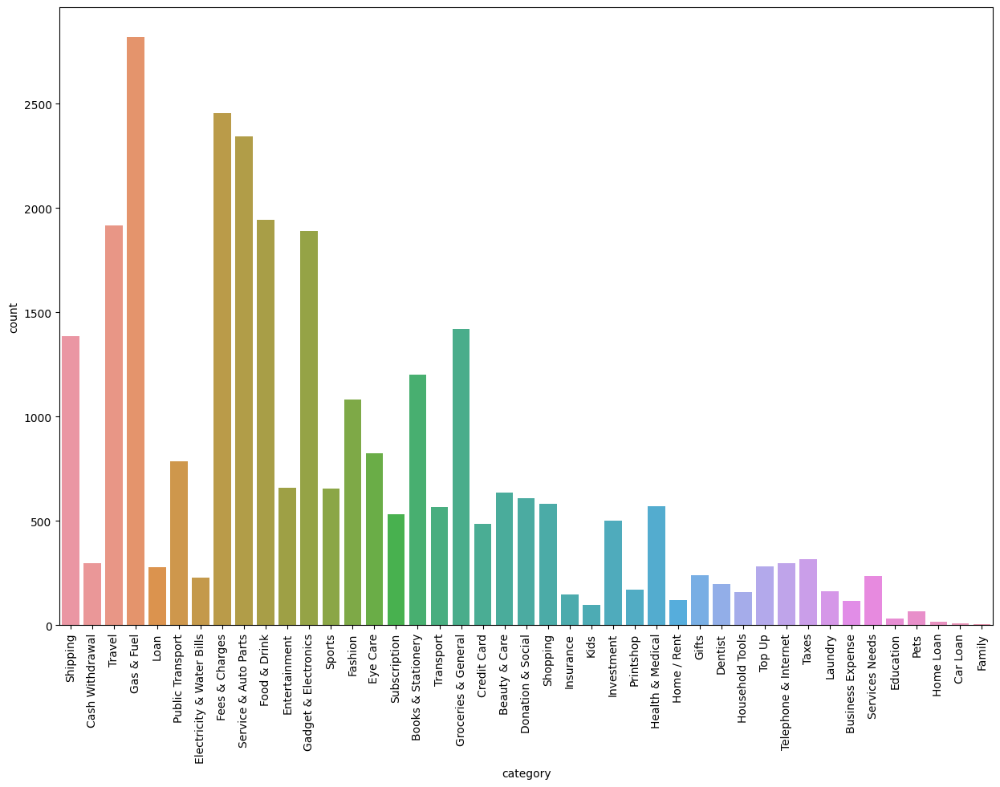

In [368]:
plt.figure(figsize=(15,10))
sns.countplot(data=df_new, x='category')
plt.xticks(rotation=90)
plt.show()

In [369]:
df_new.to_csv('/content/drive/MyDrive/df_new_fix.csv', index=False)